# Session (475165_f5_stage2_day7)

# Processing of Raw Calcium Cortical Data into dFF tiff Stacks

In [1]:
"""install the packages to run this code"""
#%pip install matplotlib tifffile scipy tqdm pybaselines opencv-python imagecodecs pickle #plotly #need to do this through conda install

'install the packages to run this code'

In [2]:
session = "475165_f5_stage2_day7" #cageID_mouseID_stage_day

## Step 1: importing the proper libraries

note: all packaged are compatible with Python 3.12 as of 2024, Feb 22

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import tifffile
import cv2
from scipy import interpolate
from scipy.interpolate import interp1d
from scipy.ndimage import gaussian_filter
from scipy.signal import cheby1, filtfilt, find_peaks, peak_widths
import scipy
from tqdm import tqdm
%matplotlib inline
import plotly.express as px
import imagecodecs
from matplotlib.animation import FuncAnimation
import pickle
from pybaselines import Baseline
import pandas as pd
from ipywidgets import interact, FloatSlider
import matplotlib.gridspec as gridspec

from preprocessing_functions import (load_frames, 
                                        interactive_plot, 
                                        plot_frame, 
                                        temporal_mean, 
                                        remove_dark_frames, 
                                        extract_artifacts, 
                                        interpolate, 
                                        dff, 
                                        smoothing, 
                                        save_tiff,
                                        load_txt,
                                        extract_txt_flashes,
                                        load_masks, 
                                        avg_trials,
                                        extract_v1,
                                        animate_figure, 
extract_success,
sort_success,
extract_nogo)

## Step 2: importing and exporting from the script

### 2A: Manual importing data and paths

Please insert the file path for the tif stack as a 3d array

In [4]:
missing_artifacts = "FALSE"

In [5]:
cohort = "3_third_cohort"

### 2B: Manual Exporting data path

In [6]:
parts = session.split("_") # Split the string by underscores

cageID_mouseID = f"{parts[0]}_{parts[1]}" #cageID_mouseID
cageID, mouseID = parts[0], parts[1] #newv2
day = parts[3]  # what day of the stage they are in

print(f"cageID_mouseID = \"{cageID_mouseID}\"")
print(f"day = \"{day}\"")

cageID_mouseID = "475165_f5"
day = "day7"


### 2C: autonomous loadings and exporting lines !do not need to manipulate!

#### 2C.1: loading frames in

In [7]:
common_cortical_path = "X:/RaymondLab/1_Kai/1_cortical_data/"

In [8]:
video = f"{common_cortical_path}/{cohort}/stage2/{session}.tif"

In [9]:
frame_number = 6000 #please insert frame number to view
frames = load_frames(video); #loading in tif stack, this will take a little while

loading video, please wait...


dimensions are (35398, 128, 128) as a uint16


#### 2C.2: Tiff stack (spatial view videos) export

make sure folders exists: files are organized by common_tiff_path -> stage -> day -> full,single,double -> File_name(cage_mouseid_stage_day_condition)

In [10]:
common_tiff_path = "X:/RaymondLab/1_Kai/3_processed_data/1_tiff_stacks/stage2/"

In [11]:
tiff_path_full = f"{common_tiff_path}{day}/full_frame/{cageID_mouseID}_stage2_{day}_full_frame.tiff"
tiff_path_single = f"{common_tiff_path}{day}/single/{cageID_mouseID}_stage2_{day}_single.tiff"
tiff_path_double = f"{common_tiff_path}{day}/double/{cageID_mouseID}_stage2_{day}_double.tiff"

#### 2C.3: Pickle export timeseries array

make sure folders exist: files are organized by common_pickle_path -> stage -> day -> single,double -> ROI -> File_name(cage_mouseid_stage_day_condition)

In [12]:
common_pickle_path = "X:/RaymondLab/1_Kai/3_processed_data/2_pickle/stage2/"

In [13]:
pickle_single_v1 = f"{common_pickle_path}{day}/single/v1/{cageID_mouseID}_stage2_{day}_single_v1.pickle"
pickle_double_v1 = f"{common_pickle_path}{day}/double/v1/{cageID_mouseID}_stage2_{day}_double_v1.pickle"

pickle_single_success_ff = f"{common_pickle_path}single/success/full_frame/{cageID_mouseID}_stage2_{day}_single_success_ff.pickle"
pickle_double_success_ff = f"{common_pickle_path}double/success/full_frame/{cageID_mouseID}_stage2_{day}_double_success_ff.pickle"
pickle_nogo_success_ff = f"{common_pickle_path}nogo/success/full_frame/{cageID_mouseID}_stage2_{day}_nogo_success_ff.pickle"

pickle_single_fail_ff = f"{common_pickle_path}single/fail/full_frame/{cageID_mouseID}_stage2_{day}_single_fail_ff.pickle"
pickle_double_fail_ff = f"{common_pickle_path}double/fail/full_frame/{cageID_mouseID}_stage2_{day}_double_fail_ff.pickle"
pickle_nogo_fail_ff = f"{common_pickle_path}nogo/fail/full_frame/{cageID_mouseID}_stage2_{day}_nogo_fail_ff.pickle"

## Step 3: Plot of Raw Frames and Timecourse

### 3A: Plotting raw frame example, to make sure the tif stack loaded in properly.


Make sure the frames are a 3d array, two figures will be generated, a greyscaled and colormapped. They are technically identical

frame number 6000 plotted


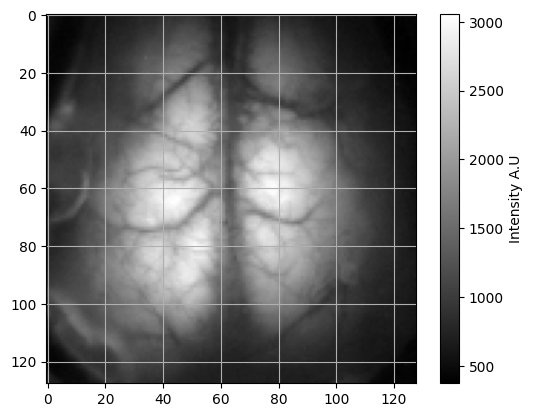

frame number 6000 plotted


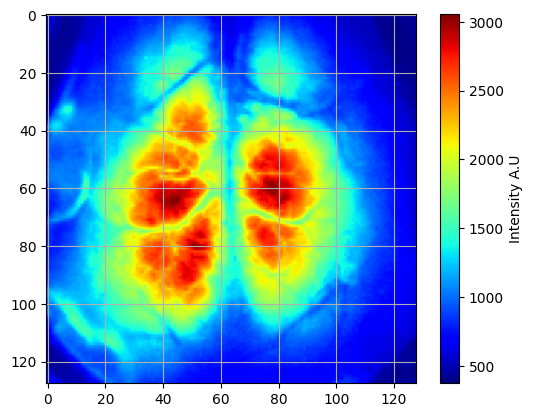

In [14]:
plot_frame(frames, frame_number, cmap = 'grey', color_label = "Intensity A.U")
plot_frame(frames, frame_number, cmap = 'jet', color_label = "Intensity A.U")

### 3B: Plot of the raw signal mean for each frame over the length of the experiment

Mean time course of the raw signal

In [15]:
mean_timecourse = temporal_mean(frames);

default 20% threshold is 391.04677734375 Determine if adjustments need to be made


## Step 4: Mean Timecourse without Darkframes at Start and End

#### 4A: plot of timecourse

#### 4B: number of single and double flashes as well as total number.

In [16]:
darkf_removed = remove_dark_frames(frames, mean_timecourse, 0.35)
darkf_removed_timecourse, darkf_removed_frames = darkf_removed[0], darkf_removed[1] #first one is the timecourse with no 3d, second is the 3d array

threshold determined to be: 439.92762451171876


#### 4C: pybaselines (only run if missing flashes)

In [17]:
if missing_artifacts == "TRUE":
    x = np.linspace(0, len(darkf_removed_timecourse), len(darkf_removed_timecourse))
    baseline_fitter = Baseline(x_data=x)

    smoothed_imodpoly = baseline_fitter.imodpoly(darkf_removed_timecourse, poly_order=3, num_std=0.7)[0]
    flattened = darkf_removed_timecourse-smoothed_imodpoly

    artifacts = extract_artifacts(flattened)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

    #plotting moving mean and signal
    fig = px.line(y = [flattened])
    fig.update_layout(
    title= "mean timecourse with moving average overlay",
    xaxis=dict(title="frame number (30 fps)"),
    yaxis=dict(title="intensity value (A.U)"),
    xaxis_rangeslider_visible=True,
    showlegend=True)

    fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

    fig.show()

    plt.figure()
    plt.plot(darkf_removed_timecourse, label='Subset Signal')
    plt.plot(smoothed_imodpoly, '--', label='Smoothed imodpoly')
    plt.legend()
    plt.show()

!! If the total does not match the single and double combined, check dataset!!

In [18]:
if missing_artifacts == "FALSE": #newv2
    artifacts = extract_artifacts(darkf_removed_timecourse)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

Number of double_flash: 62
Number of double_flash pairs: 31
Number of single_flash: 44
Number of total flashes: 106


## Step 5: Artifact Removal and DFF

### 5A: Plot of mean timecourse with artifacts removed


plot is generated with interpolated frames where the artifacts were, approximately 5 frames

In [19]:
no_artifact_timecourse = interpolate(darkf_removed_frames, artifact_indices, 5)

interpolating artifact frames...


  0%|                                                                                          | 0/106 [00:00<?, ?it/s]

  1%|▊                                                                                 | 1/106 [00:01<02:16,  1.30s/it]

  2%|█▌                                                                                | 2/106 [00:02<02:18,  1.33s/it]

  3%|██▎                                                                               | 3/106 [00:03<02:13,  1.30s/it]

  4%|███                                                                               | 4/106 [00:05<02:11,  1.29s/it]

  5%|███▊                                                                              | 5/106 [00:06<02:11,  1.30s/it]

  6%|████▋                                                                             | 6/106 [00:07<02:12,  1.33s/it]

  7%|█████▍                                                                            | 7/106 [00:09<02:12,  1.33s/it]

  8%|██████▏                                                                           | 8/106 [00:10<02:07,  1.30s/it]

  8%|██████▉                                                                           | 9/106 [00:11<02:08,  1.32s/it]

  9%|███████▋                                                                         | 10/106 [00:13<02:10,  1.36s/it]

 10%|████████▍                                                                        | 11/106 [00:14<02:08,  1.35s/it]

 11%|█████████▏                                                                       | 12/106 [00:16<02:08,  1.36s/it]

 12%|█████████▉                                                                       | 13/106 [00:17<02:04,  1.34s/it]

 13%|██████████▋                                                                      | 14/106 [00:18<02:01,  1.32s/it]

 14%|███████████▍                                                                     | 15/106 [00:19<02:01,  1.34s/it]

 15%|████████████▏                                                                    | 16/106 [00:21<02:00,  1.34s/it]

 16%|████████████▉                                                                    | 17/106 [00:22<01:56,  1.31s/it]

 17%|█████████████▊                                                                   | 18/106 [00:23<01:54,  1.31s/it]

 18%|██████████████▌                                                                  | 19/106 [00:25<01:55,  1.32s/it]

 19%|███████████████▎                                                                 | 20/106 [00:26<01:53,  1.32s/it]

 20%|████████████████                                                                 | 21/106 [00:27<01:48,  1.28s/it]

 21%|████████████████▊                                                                | 22/106 [00:29<01:51,  1.32s/it]

 22%|█████████████████▌                                                               | 23/106 [00:30<01:51,  1.34s/it]

 23%|██████████████████▎                                                              | 24/106 [00:31<01:51,  1.36s/it]

 24%|███████████████████                                                              | 25/106 [00:33<01:49,  1.35s/it]

 25%|███████████████████▊                                                             | 26/106 [00:34<01:47,  1.35s/it]

 25%|████████████████████▋                                                            | 27/106 [00:35<01:47,  1.37s/it]

 26%|█████████████████████▍                                                           | 28/106 [00:37<01:49,  1.41s/it]

 27%|██████████████████████▏                                                          | 29/106 [00:38<01:45,  1.38s/it]

 28%|██████████████████████▉                                                          | 30/106 [00:40<01:44,  1.37s/it]

 29%|███████████████████████▋                                                         | 31/106 [00:41<01:46,  1.42s/it]

 30%|████████████████████████▍                                                        | 32/106 [00:42<01:42,  1.39s/it]

 31%|█████████████████████████▏                                                       | 33/106 [00:44<01:38,  1.35s/it]

 32%|█████████████████████████▉                                                       | 34/106 [00:45<01:38,  1.36s/it]

 33%|██████████████████████████▋                                                      | 35/106 [00:47<01:36,  1.36s/it]

 34%|███████████████████████████▌                                                     | 36/106 [00:48<01:33,  1.34s/it]

 35%|████████████████████████████▎                                                    | 37/106 [00:49<01:29,  1.30s/it]

 36%|█████████████████████████████                                                    | 38/106 [00:50<01:29,  1.32s/it]

 37%|█████████████████████████████▊                                                   | 39/106 [00:52<01:27,  1.31s/it]

 38%|██████████████████████████████▌                                                  | 40/106 [00:53<01:24,  1.28s/it]

 39%|███████████████████████████████▎                                                 | 41/106 [00:54<01:22,  1.27s/it]

 40%|████████████████████████████████                                                 | 42/106 [00:55<01:21,  1.28s/it]

 41%|████████████████████████████████▊                                                | 43/106 [00:57<01:22,  1.32s/it]

 42%|█████████████████████████████████▌                                               | 44/106 [00:58<01:23,  1.34s/it]

 42%|██████████████████████████████████▍                                              | 45/106 [01:00<01:21,  1.34s/it]

 43%|███████████████████████████████████▏                                             | 46/106 [01:01<01:20,  1.35s/it]

 44%|███████████████████████████████████▉                                             | 47/106 [01:02<01:17,  1.31s/it]

 45%|████████████████████████████████████▋                                            | 48/106 [01:03<01:15,  1.30s/it]

 46%|█████████████████████████████████████▍                                           | 49/106 [01:05<01:12,  1.27s/it]

 47%|██████████████████████████████████████▏                                          | 50/106 [01:06<01:11,  1.27s/it]

 48%|██████████████████████████████████████▉                                          | 51/106 [01:07<01:10,  1.28s/it]

 49%|███████████████████████████████████████▋                                         | 52/106 [01:08<01:07,  1.25s/it]

 50%|████████████████████████████████████████▌                                        | 53/106 [01:10<01:07,  1.28s/it]

 51%|█████████████████████████████████████████▎                                       | 54/106 [01:11<01:07,  1.29s/it]

 52%|██████████████████████████████████████████                                       | 55/106 [01:13<01:09,  1.36s/it]

 53%|██████████████████████████████████████████▊                                      | 56/106 [01:14<01:07,  1.36s/it]

 54%|███████████████████████████████████████████▌                                     | 57/106 [01:15<01:08,  1.40s/it]

 55%|████████████████████████████████████████████▎                                    | 58/106 [01:17<01:04,  1.34s/it]

 56%|█████████████████████████████████████████████                                    | 59/106 [01:18<01:02,  1.32s/it]

 57%|█████████████████████████████████████████████▊                                   | 60/106 [01:19<00:59,  1.29s/it]

 58%|██████████████████████████████████████████████▌                                  | 61/106 [01:21<01:00,  1.35s/it]

 58%|███████████████████████████████████████████████▍                                 | 62/106 [01:22<00:58,  1.33s/it]

 59%|████████████████████████████████████████████████▏                                | 63/106 [01:23<00:55,  1.30s/it]

 60%|████████████████████████████████████████████████▉                                | 64/106 [01:24<00:55,  1.33s/it]

 61%|█████████████████████████████████████████████████▋                               | 65/106 [01:26<00:54,  1.33s/it]

 62%|██████████████████████████████████████████████████▍                              | 66/106 [01:27<00:53,  1.33s/it]

 63%|███████████████████████████████████████████████████▏                             | 67/106 [01:28<00:50,  1.30s/it]

 64%|███████████████████████████████████████████████████▉                             | 68/106 [01:30<00:51,  1.36s/it]

 65%|████████████████████████████████████████████████████▋                            | 69/106 [01:31<00:49,  1.33s/it]

 66%|█████████████████████████████████████████████████████▍                           | 70/106 [01:32<00:47,  1.32s/it]

 67%|██████████████████████████████████████████████████████▎                          | 71/106 [01:34<00:47,  1.35s/it]

 68%|███████████████████████████████████████████████████████                          | 72/106 [01:35<00:45,  1.33s/it]

 69%|███████████████████████████████████████████████████████▊                         | 73/106 [01:36<00:43,  1.30s/it]

 70%|████████████████████████████████████████████████████████▌                        | 74/106 [01:38<00:42,  1.32s/it]

 71%|█████████████████████████████████████████████████████████▎                       | 75/106 [01:39<00:41,  1.33s/it]

 72%|██████████████████████████████████████████████████████████                       | 76/106 [01:41<00:40,  1.35s/it]

 73%|██████████████████████████████████████████████████████████▊                      | 77/106 [01:42<00:38,  1.33s/it]

 74%|███████████████████████████████████████████████████████████▌                     | 78/106 [01:43<00:38,  1.37s/it]

 75%|████████████████████████████████████████████████████████████▎                    | 79/106 [01:45<00:36,  1.34s/it]

 75%|█████████████████████████████████████████████████████████████▏                   | 80/106 [01:46<00:35,  1.36s/it]

 76%|█████████████████████████████████████████████████████████████▉                   | 81/106 [01:47<00:33,  1.35s/it]

 77%|██████████████████████████████████████████████████████████████▋                  | 82/106 [01:49<00:31,  1.33s/it]

 78%|███████████████████████████████████████████████████████████████▍                 | 83/106 [01:50<00:30,  1.34s/it]

 79%|████████████████████████████████████████████████████████████████▏                | 84/106 [01:51<00:29,  1.36s/it]

 80%|████████████████████████████████████████████████████████████████▉                | 85/106 [01:53<00:28,  1.34s/it]

 81%|█████████████████████████████████████████████████████████████████▋               | 86/106 [01:54<00:26,  1.32s/it]

 82%|██████████████████████████████████████████████████████████████████▍              | 87/106 [01:55<00:25,  1.32s/it]

 83%|███████████████████████████████████████████████████████████████████▏             | 88/106 [01:57<00:24,  1.34s/it]

 84%|████████████████████████████████████████████████████████████████████             | 89/106 [01:58<00:22,  1.30s/it]

 85%|████████████████████████████████████████████████████████████████████▊            | 90/106 [01:59<00:21,  1.33s/it]

 86%|█████████████████████████████████████████████████████████████████████▌           | 91/106 [02:01<00:19,  1.33s/it]

 87%|██████████████████████████████████████████████████████████████████████▎          | 92/106 [02:02<00:19,  1.37s/it]

 88%|███████████████████████████████████████████████████████████████████████          | 93/106 [02:03<00:17,  1.35s/it]

 89%|███████████████████████████████████████████████████████████████████████▊         | 94/106 [02:05<00:15,  1.33s/it]

 90%|████████████████████████████████████████████████████████████████████████▌        | 95/106 [02:06<00:15,  1.37s/it]

 91%|█████████████████████████████████████████████████████████████████████████▎       | 96/106 [02:07<00:13,  1.34s/it]

 92%|██████████████████████████████████████████████████████████████████████████       | 97/106 [02:09<00:12,  1.35s/it]

 92%|██████████████████████████████████████████████████████████████████████████▉      | 98/106 [02:10<00:11,  1.38s/it]

 93%|███████████████████████████████████████████████████████████████████████████▋     | 99/106 [02:11<00:09,  1.37s/it]

 94%|███████████████████████████████████████████████████████████████████████████▍    | 100/106 [02:13<00:08,  1.36s/it]

 95%|████████████████████████████████████████████████████████████████████████████▏   | 101/106 [02:14<00:06,  1.32s/it]

 96%|████████████████████████████████████████████████████████████████████████████▉   | 102/106 [02:15<00:05,  1.30s/it]

 97%|█████████████████████████████████████████████████████████████████████████████▋  | 103/106 [02:17<00:03,  1.31s/it]

 98%|██████████████████████████████████████████████████████████████████████████████▍ | 104/106 [02:18<00:02,  1.32s/it]

 99%|███████████████████████████████████████████████████████████████████████████████▏| 105/106 [02:19<00:01,  1.31s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 106/106 [02:21<00:00,  1.32s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 106/106 [02:21<00:00,  1.33s/it]

### 5B: Calculating dff


Dff calculated from the 3d array without artifacts, darkframes removed, and interpolated the space where the artifacts were. Then plotting of the signal with the 10s moving mean before dff is applied. dff is applied using this moving mean onto the signal

In [20]:
dff_array = dff(no_artifact_timecourse, 10, 30);
dff_signal, moving_average = dff_array[0], dff_array[1]

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

 19%|███████████████                                                                 | 24/128 [00:00<00:00, 222.30it/s]

 38%|██████████████████████████████▋                                                 | 49/128 [00:00<00:00, 237.81it/s]

 59%|██████████████████████████████████████████████▉                                 | 75/128 [00:00<00:00, 245.69it/s]

 78%|█████████████████████████████████████████████████████████████▋                 | 100/128 [00:00<00:00, 239.94it/s]

 98%|█████████████████████████████████████████████████████████████████████████████▏ | 125/128 [00:00<00:00, 238.49it/s]

100%|███████████████████████████████████████████████████████████████████████████████| 128/128 [00:00<00:00, 238.38it/s]

  0%|                                                                                        | 0/34165 [00:00<?, ?it/s]

  0%|                                                                              | 23/34165 [00:00<02:35, 219.12it/s]

  0%|                                                                              | 52/34165 [00:00<02:13, 255.61it/s]

  0%|▏                                                                             | 81/34165 [00:00<02:08, 266.27it/s]

  0%|▏                                                                            | 108/34165 [00:00<02:16, 250.36it/s]

  0%|▎                                                                            | 134/34165 [00:00<02:19, 243.73it/s]

  0%|▎                                                                            | 159/34165 [00:00<02:21, 239.65it/s]

  1%|▍                                                                            | 184/34165 [00:00<02:25, 234.22it/s]

  1%|▍                                                                            | 211/34165 [00:00<02:19, 244.16it/s]

  1%|▌                                                                            | 239/34165 [00:00<02:13, 254.09it/s]

  1%|▌                                                                            | 265/34165 [00:01<02:20, 241.50it/s]

  1%|▋                                                                            | 290/34165 [00:01<02:19, 242.57it/s]

  1%|▋                                                                            | 317/34165 [00:01<02:15, 249.09it/s]

  1%|▊                                                                            | 343/34165 [00:01<02:16, 247.96it/s]

  1%|▊                                                                            | 371/34165 [00:01<02:12, 254.33it/s]

  1%|▉                                                                            | 397/34165 [00:01<02:15, 248.77it/s]

  1%|▉                                                                            | 426/34165 [00:01<02:10, 257.69it/s]

  1%|█                                                                            | 452/34165 [00:01<02:12, 253.98it/s]

  1%|█                                                                            | 480/34165 [00:01<02:09, 259.27it/s]

  1%|█▏                                                                           | 506/34165 [00:02<02:12, 254.34it/s]

  2%|█▏                                                                           | 534/34165 [00:02<02:09, 259.53it/s]

  2%|█▎                                                                           | 562/34165 [00:02<02:08, 262.45it/s]

  2%|█▎                                                                           | 590/34165 [00:02<02:06, 264.51it/s]

  2%|█▍                                                                           | 617/34165 [00:02<02:08, 260.07it/s]

  2%|█▍                                                                           | 644/34165 [00:02<02:07, 262.21it/s]

  2%|█▌                                                                           | 671/34165 [00:02<02:07, 262.91it/s]

  2%|█▌                                                                           | 698/34165 [00:02<02:12, 253.15it/s]

  2%|█▋                                                                           | 725/34165 [00:02<02:10, 256.52it/s]

  2%|█▋                                                                           | 754/34165 [00:02<02:06, 263.17it/s]

  2%|█▊                                                                           | 781/34165 [00:03<02:14, 247.67it/s]

  2%|█▊                                                                           | 806/34165 [00:03<02:20, 237.66it/s]

  2%|█▊                                                                           | 831/34165 [00:03<02:18, 239.87it/s]

  3%|█▉                                                                           | 856/34165 [00:03<02:20, 236.75it/s]

  3%|█▉                                                                           | 881/34165 [00:03<02:19, 239.16it/s]

  3%|██                                                                           | 909/34165 [00:03<02:14, 248.03it/s]

  3%|██                                                                           | 934/34165 [00:03<02:18, 240.32it/s]

  3%|██▏                                                                          | 959/34165 [00:03<02:28, 223.99it/s]

  3%|██▏                                                                          | 988/34165 [00:03<02:18, 239.39it/s]

  3%|██▎                                                                         | 1013/34165 [00:04<02:17, 240.35it/s]

  3%|██▎                                                                         | 1042/34165 [00:04<02:10, 252.98it/s]

  3%|██▍                                                                         | 1068/34165 [00:04<02:12, 250.71it/s]

  3%|██▍                                                                         | 1094/34165 [00:04<02:15, 244.96it/s]

  3%|██▍                                                                         | 1119/34165 [00:04<02:19, 236.36it/s]

  3%|██▌                                                                         | 1145/34165 [00:04<02:16, 241.65it/s]

  3%|██▌                                                                         | 1170/34165 [00:04<02:21, 233.42it/s]

  3%|██▋                                                                         | 1194/34165 [00:04<02:20, 233.97it/s]

  4%|██▋                                                                         | 1218/34165 [00:04<02:23, 229.19it/s]

  4%|██▊                                                                         | 1241/34165 [00:05<02:31, 217.72it/s]

  4%|██▊                                                                         | 1268/34165 [00:05<02:22, 230.97it/s]

  4%|██▉                                                                         | 1295/34165 [00:05<02:16, 240.00it/s]

  4%|██▉                                                                         | 1321/34165 [00:05<02:14, 245.04it/s]

  4%|██▉                                                                         | 1346/34165 [00:05<02:24, 227.35it/s]

  4%|███                                                                         | 1373/34165 [00:05<02:17, 237.90it/s]

  4%|███                                                                         | 1399/34165 [00:05<02:14, 243.78it/s]

  4%|███▏                                                                        | 1425/34165 [00:05<02:12, 247.15it/s]

  4%|███▏                                                                        | 1452/34165 [00:05<02:09, 251.74it/s]

  4%|███▎                                                                        | 1478/34165 [00:06<02:11, 248.39it/s]

  4%|███▎                                                                        | 1506/34165 [00:06<02:07, 255.33it/s]

  4%|███▍                                                                        | 1534/34165 [00:06<02:05, 261.00it/s]

  5%|███▍                                                                        | 1561/34165 [00:06<02:04, 261.37it/s]

  5%|███▌                                                                        | 1590/34165 [00:06<02:02, 266.65it/s]

  5%|███▌                                                                        | 1617/34165 [00:06<02:02, 265.33it/s]

  5%|███▋                                                                        | 1646/34165 [00:06<02:00, 270.21it/s]

  5%|███▋                                                                        | 1674/34165 [00:06<02:03, 263.08it/s]

  5%|███▊                                                                        | 1703/34165 [00:06<02:01, 267.77it/s]

  5%|███▊                                                                        | 1730/34165 [00:06<02:05, 259.45it/s]

  5%|███▉                                                                        | 1757/34165 [00:07<02:11, 246.33it/s]

  5%|███▉                                                                        | 1782/34165 [00:07<02:19, 232.58it/s]

  5%|████                                                                        | 1808/34165 [00:07<02:15, 238.09it/s]

  5%|████                                                                        | 1832/34165 [00:07<02:27, 219.75it/s]

  5%|████▏                                                                       | 1858/34165 [00:07<02:20, 229.31it/s]

  6%|████▏                                                                       | 1884/34165 [00:07<02:16, 235.83it/s]

  6%|████▏                                                                       | 1908/34165 [00:07<02:22, 226.23it/s]

  6%|████▎                                                                       | 1934/34165 [00:07<02:18, 233.02it/s]

  6%|████▎                                                                       | 1961/34165 [00:07<02:13, 240.73it/s]

  6%|████▍                                                                       | 1986/34165 [00:08<02:18, 232.80it/s]

  6%|████▍                                                                       | 2013/34165 [00:08<02:14, 239.22it/s]

  6%|████▌                                                                       | 2038/34165 [00:08<02:18, 231.82it/s]

  6%|████▌                                                                       | 2062/34165 [00:08<02:20, 229.02it/s]

  6%|████▋                                                                       | 2086/34165 [00:08<02:19, 230.18it/s]

  6%|████▋                                                                       | 2110/34165 [00:08<02:17, 232.33it/s]

  6%|████▋                                                                       | 2134/34165 [00:08<02:20, 228.64it/s]

  6%|████▊                                                                       | 2159/34165 [00:08<02:17, 232.89it/s]

  6%|████▊                                                                       | 2186/34165 [00:08<02:12, 241.53it/s]

  6%|████▉                                                                       | 2211/34165 [00:09<02:14, 237.28it/s]

  7%|████▉                                                                       | 2235/34165 [00:09<02:16, 234.52it/s]

  7%|█████                                                                       | 2259/34165 [00:09<02:25, 219.73it/s]

  7%|█████                                                                       | 2285/34165 [00:09<02:19, 228.37it/s]

  7%|█████▏                                                                      | 2312/34165 [00:09<02:13, 239.43it/s]

  7%|█████▏                                                                      | 2339/34165 [00:09<02:08, 246.78it/s]

  7%|█████▎                                                                      | 2366/34165 [00:09<02:06, 251.34it/s]

  7%|█████▎                                                                      | 2392/34165 [00:09<02:05, 253.14it/s]

  7%|█████▍                                                                      | 2418/34165 [00:09<02:07, 249.34it/s]

  7%|█████▍                                                                      | 2444/34165 [00:10<02:12, 239.93it/s]

  7%|█████▍                                                                      | 2470/34165 [00:10<02:09, 244.25it/s]

  7%|█████▌                                                                      | 2495/34165 [00:10<02:11, 240.41it/s]

  7%|█████▌                                                                      | 2520/34165 [00:10<02:10, 243.11it/s]

  7%|█████▋                                                                      | 2545/34165 [00:10<02:15, 233.04it/s]

  8%|█████▋                                                                      | 2569/34165 [00:10<02:16, 231.11it/s]

  8%|█████▊                                                                      | 2594/34165 [00:10<02:15, 233.84it/s]

  8%|█████▊                                                                      | 2618/34165 [00:10<02:18, 227.80it/s]

  8%|█████▉                                                                      | 2646/34165 [00:10<02:10, 241.93it/s]

  8%|█████▉                                                                      | 2674/34165 [00:10<02:04, 252.18it/s]

  8%|██████                                                                      | 2703/34165 [00:11<02:00, 260.18it/s]

  8%|██████                                                                      | 2732/34165 [00:11<01:58, 265.79it/s]

  8%|██████▏                                                                     | 2761/34165 [00:11<01:56, 270.51it/s]

  8%|██████▏                                                                     | 2789/34165 [00:11<01:55, 272.51it/s]

  8%|██████▎                                                                     | 2818/34165 [00:11<01:53, 275.25it/s]

  8%|██████▎                                                                     | 2846/34165 [00:11<01:53, 275.86it/s]

  8%|██████▍                                                                     | 2874/34165 [00:11<01:57, 266.12it/s]

  8%|██████▍                                                                     | 2901/34165 [00:11<02:05, 248.51it/s]

  9%|██████▌                                                                     | 2929/34165 [00:11<02:02, 255.21it/s]

  9%|██████▌                                                                     | 2955/34165 [00:12<02:04, 251.62it/s]

  9%|██████▋                                                                     | 2981/34165 [00:12<02:07, 245.00it/s]

  9%|██████▋                                                                     | 3008/34165 [00:12<02:04, 249.94it/s]

  9%|██████▊                                                                     | 3037/34165 [00:12<02:00, 259.15it/s]

  9%|██████▊                                                                     | 3066/34165 [00:12<01:57, 264.99it/s]

  9%|██████▉                                                                     | 3093/34165 [00:12<01:57, 264.90it/s]

  9%|██████▉                                                                     | 3120/34165 [00:12<02:01, 256.02it/s]

  9%|███████                                                                     | 3148/34165 [00:12<01:59, 259.92it/s]

  9%|███████                                                                     | 3175/34165 [00:12<02:08, 240.72it/s]

  9%|███████                                                                     | 3201/34165 [00:13<02:06, 245.34it/s]

  9%|███████▏                                                                    | 3226/34165 [00:13<02:08, 239.95it/s]

 10%|███████▏                                                                    | 3251/34165 [00:13<02:11, 235.53it/s]

 10%|███████▎                                                                    | 3275/34165 [00:13<02:16, 226.05it/s]

 10%|███████▎                                                                    | 3302/34165 [00:13<02:10, 235.61it/s]

 10%|███████▍                                                                    | 3327/34165 [00:13<02:09, 237.67it/s]

 10%|███████▍                                                                    | 3353/34165 [00:13<02:06, 242.67it/s]

 10%|███████▌                                                                    | 3380/34165 [00:13<02:03, 249.12it/s]

 10%|███████▌                                                                    | 3405/34165 [00:13<02:03, 248.68it/s]

 10%|███████▋                                                                    | 3432/34165 [00:13<02:00, 254.20it/s]

 10%|███████▋                                                                    | 3458/34165 [00:14<02:05, 243.75it/s]

 10%|███████▋                                                                    | 3483/34165 [00:14<02:05, 244.86it/s]

 10%|███████▊                                                                    | 3509/34165 [00:14<02:03, 247.83it/s]

 10%|███████▊                                                                    | 3536/34165 [00:14<02:02, 249.94it/s]

 10%|███████▉                                                                    | 3562/34165 [00:14<02:05, 243.01it/s]

 10%|███████▉                                                                    | 3587/34165 [00:14<02:06, 242.27it/s]

 11%|████████                                                                    | 3612/34165 [00:14<02:14, 227.53it/s]

 11%|████████                                                                    | 3639/34165 [00:14<02:08, 238.14it/s]

 11%|████████▏                                                                   | 3665/34165 [00:14<02:05, 243.20it/s]

 11%|████████▏                                                                   | 3692/34165 [00:15<02:01, 250.18it/s]

 11%|████████▎                                                                   | 3718/34165 [00:15<02:03, 246.62it/s]

 11%|████████▎                                                                   | 3747/34165 [00:15<01:58, 256.17it/s]

 11%|████████▍                                                                   | 3773/34165 [00:15<02:04, 243.92it/s]

 11%|████████▍                                                                   | 3800/34165 [00:15<02:01, 249.18it/s]

 11%|████████▌                                                                   | 3827/34165 [00:15<01:59, 254.41it/s]

 11%|████████▌                                                                   | 3853/34165 [00:15<02:04, 243.00it/s]

 11%|████████▋                                                                   | 3881/34165 [00:15<01:59, 252.72it/s]

 11%|████████▋                                                                   | 3907/34165 [00:15<02:00, 251.81it/s]

 12%|████████▋                                                                   | 3933/34165 [00:16<02:09, 233.38it/s]

 12%|████████▊                                                                   | 3957/34165 [00:16<02:09, 232.67it/s]

 12%|████████▊                                                                   | 3985/34165 [00:16<02:03, 243.86it/s]

 12%|████████▉                                                                   | 4010/34165 [00:16<02:16, 220.62it/s]

 12%|████████▉                                                                   | 4038/34165 [00:16<02:08, 234.60it/s]

 12%|█████████                                                                   | 4063/34165 [00:16<02:07, 236.25it/s]

 12%|█████████                                                                   | 4090/34165 [00:16<02:04, 241.65it/s]

 12%|█████████▏                                                                  | 4118/34165 [00:16<01:59, 251.07it/s]

 12%|█████████▏                                                                  | 4145/34165 [00:16<01:57, 255.05it/s]

 12%|█████████▎                                                                  | 4174/34165 [00:16<01:54, 262.90it/s]

 12%|█████████▎                                                                  | 4201/34165 [00:17<01:54, 262.70it/s]

 12%|█████████▍                                                                  | 4228/34165 [00:17<01:54, 261.05it/s]

 12%|█████████▍                                                                  | 4255/34165 [00:17<01:55, 259.15it/s]

 13%|█████████▌                                                                  | 4281/34165 [00:17<02:03, 241.24it/s]

 13%|█████████▌                                                                  | 4306/34165 [00:17<02:05, 237.10it/s]

 13%|█████████▋                                                                  | 4334/34165 [00:17<02:00, 248.39it/s]

 13%|█████████▋                                                                  | 4360/34165 [00:17<02:06, 235.78it/s]

 13%|█████████▊                                                                  | 4384/34165 [00:17<02:13, 222.84it/s]

 13%|█████████▊                                                                  | 4412/34165 [00:17<02:05, 237.03it/s]

 13%|█████████▊                                                                  | 4438/34165 [00:18<02:02, 242.22it/s]

 13%|█████████▉                                                                  | 4463/34165 [00:18<02:03, 239.70it/s]

 13%|█████████▉                                                                  | 4488/34165 [00:18<02:07, 232.02it/s]

 13%|██████████                                                                  | 4512/34165 [00:18<02:09, 229.77it/s]

 13%|██████████                                                                  | 4536/34165 [00:18<02:14, 220.87it/s]

 13%|██████████▏                                                                 | 4563/34165 [00:18<02:07, 232.53it/s]

 13%|██████████▏                                                                 | 4589/34165 [00:18<02:03, 238.94it/s]

 14%|██████████▎                                                                 | 4614/34165 [00:18<02:11, 225.39it/s]

 14%|██████████▎                                                                 | 4641/34165 [00:18<02:04, 236.57it/s]

 14%|██████████▍                                                                 | 4669/34165 [00:19<01:59, 246.02it/s]

 14%|██████████▍                                                                 | 4698/34165 [00:19<01:54, 256.36it/s]

 14%|██████████▌                                                                 | 4724/34165 [00:19<01:55, 254.05it/s]

 14%|██████████▌                                                                 | 4750/34165 [00:19<01:56, 251.44it/s]

 14%|██████████▌                                                                 | 4776/34165 [00:19<02:06, 233.12it/s]

 14%|██████████▋                                                                 | 4800/34165 [00:19<02:17, 212.85it/s]

 14%|██████████▋                                                                 | 4823/34165 [00:19<02:16, 215.11it/s]

 14%|██████████▊                                                                 | 4846/34165 [00:19<02:14, 218.56it/s]

 14%|██████████▊                                                                 | 4873/34165 [00:19<02:06, 230.96it/s]

 14%|██████████▉                                                                 | 4899/34165 [00:20<02:03, 236.51it/s]

 14%|██████████▉                                                                 | 4923/34165 [00:20<02:03, 236.18it/s]

 14%|███████████                                                                 | 4951/34165 [00:20<01:58, 246.01it/s]

 15%|███████████                                                                 | 4976/34165 [00:20<02:01, 240.91it/s]

 15%|███████████                                                                 | 5001/34165 [00:20<02:00, 242.85it/s]

 15%|███████████▏                                                                | 5026/34165 [00:20<02:01, 239.39it/s]

 15%|███████████▏                                                                | 5053/34165 [00:20<01:58, 245.85it/s]

 15%|███████████▎                                                                | 5080/34165 [00:20<01:55, 251.15it/s]

 15%|███████████▎                                                                | 5106/34165 [00:20<02:04, 233.61it/s]

 15%|███████████▍                                                                | 5130/34165 [00:21<02:09, 223.63it/s]

 15%|███████████▍                                                                | 5155/34165 [00:21<02:06, 228.98it/s]

 15%|███████████▌                                                                | 5184/34165 [00:21<01:58, 244.00it/s]

 15%|███████████▌                                                                | 5209/34165 [00:21<02:13, 216.84it/s]

 15%|███████████▋                                                                | 5237/34165 [00:21<02:04, 232.27it/s]

 15%|███████████▋                                                                | 5261/34165 [00:21<02:07, 227.58it/s]

 15%|███████████▊                                                                | 5285/34165 [00:21<02:08, 224.84it/s]

 16%|███████████▊                                                                | 5308/34165 [00:21<02:07, 225.66it/s]

 16%|███████████▊                                                                | 5331/34165 [00:21<02:11, 219.48it/s]

 16%|███████████▉                                                                | 5358/34165 [00:22<02:03, 232.37it/s]

 16%|███████████▉                                                                | 5385/34165 [00:22<01:59, 241.06it/s]

 16%|████████████                                                                | 5411/34165 [00:22<01:57, 244.42it/s]

 16%|████████████                                                                | 5436/34165 [00:22<02:02, 235.17it/s]

 16%|████████████▏                                                               | 5463/34165 [00:22<01:58, 242.32it/s]

 16%|████████████▏                                                               | 5490/34165 [00:22<01:55, 248.83it/s]

 16%|████████████▎                                                               | 5515/34165 [00:22<01:56, 246.35it/s]

 16%|████████████▎                                                               | 5542/34165 [00:22<01:53, 251.77it/s]

 16%|████████████▍                                                               | 5568/34165 [00:22<01:54, 249.11it/s]

 16%|████████████▍                                                               | 5593/34165 [00:22<02:00, 236.37it/s]

 16%|████████████▍                                                               | 5617/34165 [00:23<02:07, 224.15it/s]

 17%|████████████▌                                                               | 5644/34165 [00:23<02:00, 236.15it/s]

 17%|████████████▌                                                               | 5670/34165 [00:23<01:57, 241.54it/s]

 17%|████████████▋                                                               | 5697/34165 [00:23<01:54, 247.58it/s]

 17%|████████████▋                                                               | 5724/34165 [00:23<01:53, 251.17it/s]

 17%|████████████▊                                                               | 5750/34165 [00:23<01:52, 253.02it/s]

 17%|████████████▊                                                               | 5778/34165 [00:23<01:48, 260.81it/s]

 17%|████████████▉                                                               | 5805/34165 [00:23<01:57, 241.38it/s]

 17%|████████████▉                                                               | 5830/34165 [00:23<01:57, 240.99it/s]

 17%|█████████████                                                               | 5857/34165 [00:24<01:54, 247.68it/s]

 17%|█████████████                                                               | 5882/34165 [00:24<01:54, 246.77it/s]

 17%|█████████████▏                                                              | 5911/34165 [00:24<01:49, 257.91it/s]

 17%|█████████████▏                                                              | 5937/34165 [00:24<01:51, 252.67it/s]

 17%|█████████████▎                                                              | 5964/34165 [00:24<01:50, 256.22it/s]

 18%|█████████████▎                                                              | 5990/34165 [00:24<01:54, 245.22it/s]

 18%|█████████████▍                                                              | 6015/34165 [00:24<01:59, 235.89it/s]

 18%|█████████████▍                                                              | 6039/34165 [00:24<02:01, 231.88it/s]

 18%|█████████████▍                                                              | 6065/34165 [00:24<01:57, 238.46it/s]

 18%|█████████████▌                                                              | 6089/34165 [00:25<02:02, 229.12it/s]

 18%|█████████████▌                                                              | 6114/34165 [00:25<02:00, 233.70it/s]

 18%|█████████████▋                                                              | 6138/34165 [00:25<02:00, 233.52it/s]

 18%|█████████████▋                                                              | 6166/34165 [00:25<01:54, 244.81it/s]

 18%|█████████████▊                                                              | 6191/34165 [00:25<01:54, 244.21it/s]

 18%|█████████████▊                                                              | 6216/34165 [00:25<01:55, 241.01it/s]

 18%|█████████████▉                                                              | 6241/34165 [00:25<02:10, 214.47it/s]

 18%|█████████████▉                                                              | 6264/34165 [00:25<02:17, 202.93it/s]

 18%|█████████████▉                                                              | 6291/34165 [00:25<02:07, 218.20it/s]

 18%|██████████████                                                              | 6316/34165 [00:26<02:03, 225.59it/s]

 19%|██████████████                                                              | 6339/34165 [00:26<02:08, 217.20it/s]

 19%|██████████████▏                                                             | 6365/34165 [00:26<02:02, 226.50it/s]

 19%|██████████████▏                                                             | 6388/34165 [00:26<02:07, 217.17it/s]

 19%|██████████████▎                                                             | 6414/34165 [00:26<02:01, 228.39it/s]

 19%|██████████████▎                                                             | 6438/34165 [00:26<02:02, 227.20it/s]

 19%|██████████████▍                                                             | 6465/34165 [00:26<01:56, 237.70it/s]

 19%|██████████████▍                                                             | 6491/34165 [00:26<01:53, 242.76it/s]

 19%|██████████████▌                                                             | 6519/34165 [00:26<01:49, 252.10it/s]

 19%|██████████████▌                                                             | 6545/34165 [00:26<01:51, 247.23it/s]

 19%|██████████████▌                                                             | 6571/34165 [00:27<01:50, 250.21it/s]

 19%|██████████████▋                                                             | 6597/34165 [00:27<01:49, 252.35it/s]

 19%|██████████████▋                                                             | 6623/34165 [00:27<01:50, 248.78it/s]

 19%|██████████████▊                                                             | 6652/34165 [00:27<01:46, 258.52it/s]

 20%|██████████████▊                                                             | 6678/34165 [00:27<01:48, 252.36it/s]

 20%|██████████████▉                                                             | 6704/34165 [00:27<01:55, 237.46it/s]

 20%|██████████████▉                                                             | 6728/34165 [00:27<02:02, 223.89it/s]

 20%|███████████████                                                             | 6751/34165 [00:27<02:01, 224.96it/s]

 20%|███████████████                                                             | 6778/34165 [00:27<01:55, 236.23it/s]

 20%|███████████████▏                                                            | 6803/34165 [00:28<01:54, 238.14it/s]

 20%|███████████████▏                                                            | 6827/34165 [00:28<01:58, 230.75it/s]

 20%|███████████████▏                                                            | 6851/34165 [00:28<02:01, 225.10it/s]

 20%|███████████████▎                                                            | 6874/34165 [00:28<02:01, 224.60it/s]

 20%|███████████████▎                                                            | 6900/34165 [00:28<01:56, 233.38it/s]

 20%|███████████████▍                                                            | 6924/34165 [00:28<01:56, 233.29it/s]

 20%|███████████████▍                                                            | 6948/34165 [00:28<02:00, 226.09it/s]

 20%|███████████████▌                                                            | 6974/34165 [00:28<01:55, 235.09it/s]

 20%|███████████████▌                                                            | 6999/34165 [00:28<01:54, 238.04it/s]

 21%|███████████████▌                                                            | 7023/34165 [00:29<01:54, 237.94it/s]

 21%|███████████████▋                                                            | 7048/34165 [00:29<01:52, 240.79it/s]

 21%|███████████████▋                                                            | 7073/34165 [00:29<01:53, 238.61it/s]

 21%|███████████████▊                                                            | 7098/34165 [00:29<01:54, 236.44it/s]

 21%|███████████████▊                                                            | 7122/34165 [00:29<01:59, 226.36it/s]

 21%|███████████████▉                                                            | 7150/34165 [00:29<01:52, 240.86it/s]

 21%|███████████████▉                                                            | 7175/34165 [00:29<01:54, 235.40it/s]

 21%|████████████████                                                            | 7201/34165 [00:29<01:51, 241.08it/s]

 21%|████████████████                                                            | 7228/34165 [00:29<01:49, 246.59it/s]

 21%|████████████████▏                                                           | 7256/34165 [00:29<01:45, 255.85it/s]

 21%|████████████████▏                                                           | 7282/34165 [00:30<01:50, 244.26it/s]

 21%|████████████████▎                                                           | 7307/34165 [00:30<01:52, 237.82it/s]

 21%|████████████████▎                                                           | 7331/34165 [00:30<01:56, 230.04it/s]

 22%|████████████████▎                                                           | 7355/34165 [00:30<01:56, 230.27it/s]

 22%|████████████████▍                                                           | 7379/34165 [00:30<02:00, 222.95it/s]

 22%|████████████████▍                                                           | 7407/34165 [00:30<01:52, 238.23it/s]

 22%|████████████████▌                                                           | 7431/34165 [00:30<01:52, 237.66it/s]

 22%|████████████████▌                                                           | 7455/34165 [00:30<01:54, 233.48it/s]

 22%|████████████████▋                                                           | 7482/34165 [00:30<01:49, 243.29it/s]

 22%|████████████████▋                                                           | 7507/34165 [00:31<02:00, 221.50it/s]

 22%|████████████████▊                                                           | 7532/34165 [00:31<01:56, 228.05it/s]

 22%|████████████████▊                                                           | 7556/34165 [00:31<02:02, 217.45it/s]

 22%|████████████████▊                                                           | 7579/34165 [00:31<02:00, 220.29it/s]

 22%|████████████████▉                                                           | 7605/34165 [00:31<01:55, 230.78it/s]

 22%|████████████████▉                                                           | 7632/34165 [00:31<01:49, 241.29it/s]

 22%|█████████████████                                                           | 7659/34165 [00:31<01:47, 247.46it/s]

 22%|█████████████████                                                           | 7686/34165 [00:31<01:44, 253.29it/s]

 23%|█████████████████▏                                                          | 7713/34165 [00:31<01:43, 256.70it/s]

 23%|█████████████████▏                                                          | 7740/34165 [00:32<01:41, 259.11it/s]

 23%|█████████████████▎                                                          | 7766/34165 [00:32<01:42, 257.13it/s]

 23%|█████████████████▎                                                          | 7792/34165 [00:32<01:47, 244.35it/s]

 23%|█████████████████▍                                                          | 7818/34165 [00:32<01:46, 247.42it/s]

 23%|█████████████████▍                                                          | 7845/34165 [00:32<01:44, 251.77it/s]

 23%|█████████████████▌                                                          | 7874/34165 [00:32<01:40, 260.61it/s]

 23%|█████████████████▌                                                          | 7903/34165 [00:32<01:38, 266.86it/s]

 23%|█████████████████▋                                                          | 7931/34165 [00:32<01:37, 270.43it/s]

 23%|█████████████████▋                                                          | 7959/34165 [00:32<01:42, 256.67it/s]

 23%|█████████████████▊                                                          | 7985/34165 [00:32<01:45, 248.50it/s]

 23%|█████████████████▊                                                          | 8011/34165 [00:33<01:47, 242.34it/s]

 24%|█████████████████▉                                                          | 8036/34165 [00:33<01:50, 237.06it/s]

 24%|█████████████████▉                                                          | 8063/34165 [00:33<01:46, 244.48it/s]

 24%|██████████████████                                                          | 8092/34165 [00:33<01:42, 255.22it/s]

 24%|██████████████████                                                          | 8120/34165 [00:33<01:40, 260.03it/s]

 24%|██████████████████▏                                                         | 8149/34165 [00:33<01:37, 265.71it/s]

 24%|██████████████████▏                                                         | 8176/34165 [00:33<01:39, 260.20it/s]

 24%|██████████████████▏                                                         | 8203/34165 [00:33<01:42, 252.18it/s]

 24%|██████████████████▎                                                         | 8229/34165 [00:33<01:43, 250.87it/s]

 24%|██████████████████▎                                                         | 8255/34165 [00:34<01:45, 245.12it/s]

 24%|██████████████████▍                                                         | 8280/34165 [00:34<01:48, 237.80it/s]

 24%|██████████████████▍                                                         | 8305/34165 [00:34<01:47, 239.89it/s]

 24%|██████████████████▌                                                         | 8330/34165 [00:34<01:49, 236.08it/s]

 24%|██████████████████▌                                                         | 8354/34165 [00:34<01:49, 235.87it/s]

 25%|██████████████████▋                                                         | 8381/34165 [00:34<01:45, 243.59it/s]

 25%|██████████████████▋                                                         | 8407/34165 [00:34<01:44, 247.64it/s]

 25%|██████████████████▊                                                         | 8435/34165 [00:34<01:40, 256.36it/s]

 25%|██████████████████▊                                                         | 8462/34165 [00:34<01:38, 259.63it/s]

 25%|██████████████████▉                                                         | 8489/34165 [00:35<01:42, 249.47it/s]

 25%|██████████████████▉                                                         | 8515/34165 [00:35<01:42, 250.36it/s]

 25%|██████████████████▉                                                         | 8541/34165 [00:35<01:47, 238.07it/s]

 25%|███████████████████                                                         | 8569/34165 [00:35<01:43, 248.41it/s]

 25%|███████████████████                                                         | 8596/34165 [00:35<01:41, 251.71it/s]

 25%|███████████████████▏                                                        | 8625/34165 [00:35<01:38, 259.72it/s]

 25%|███████████████████▏                                                        | 8652/34165 [00:35<01:38, 258.24it/s]

 25%|███████████████████▎                                                        | 8680/34165 [00:35<01:36, 263.86it/s]

 25%|███████████████████▎                                                        | 8707/34165 [00:35<01:38, 259.43it/s]

 26%|███████████████████▍                                                        | 8735/34165 [00:35<01:36, 264.63it/s]

 26%|███████████████████▍                                                        | 8762/34165 [00:36<01:37, 261.65it/s]

 26%|███████████████████▌                                                        | 8789/34165 [00:36<01:40, 253.08it/s]

 26%|███████████████████▌                                                        | 8815/34165 [00:36<01:48, 234.40it/s]

 26%|███████████████████▋                                                        | 8841/34165 [00:36<01:46, 237.51it/s]

 26%|███████████████████▋                                                        | 8866/34165 [00:36<01:45, 239.01it/s]

 26%|███████████████████▊                                                        | 8891/34165 [00:36<01:46, 238.10it/s]

 26%|███████████████████▊                                                        | 8920/34165 [00:36<01:40, 250.00it/s]

 26%|███████████████████▉                                                        | 8946/34165 [00:36<01:46, 236.65it/s]

 26%|███████████████████▉                                                        | 8976/34165 [00:36<01:40, 251.41it/s]

 26%|████████████████████                                                        | 9002/34165 [00:37<01:40, 249.64it/s]

 26%|████████████████████                                                        | 9028/34165 [00:37<01:43, 242.31it/s]

 26%|████████████████████▏                                                       | 9053/34165 [00:37<01:47, 233.40it/s]

 27%|████████████████████▏                                                       | 9078/34165 [00:37<01:45, 236.69it/s]

 27%|████████████████████▏                                                       | 9102/34165 [00:37<01:47, 233.05it/s]

 27%|████████████████████▎                                                       | 9131/34165 [00:37<01:41, 246.40it/s]

 27%|████████████████████▍                                                       | 9160/34165 [00:37<01:37, 256.68it/s]

 27%|████████████████████▍                                                       | 9186/34165 [00:37<01:44, 238.44it/s]

 27%|████████████████████▍                                                       | 9213/34165 [00:37<01:41, 245.14it/s]

 27%|████████████████████▌                                                       | 9241/34165 [00:38<01:38, 254.24it/s]

 27%|████████████████████▌                                                       | 9267/34165 [00:38<01:39, 249.49it/s]

 27%|████████████████████▋                                                       | 9293/34165 [00:38<01:40, 246.89it/s]

 27%|████████████████████▋                                                       | 9318/34165 [00:38<01:42, 242.28it/s]

 27%|████████████████████▊                                                       | 9343/34165 [00:38<01:47, 231.97it/s]

 27%|████████████████████▊                                                       | 9367/34165 [00:38<01:50, 223.65it/s]

 27%|████████████████████▉                                                       | 9390/34165 [00:38<01:59, 207.13it/s]

 28%|████████████████████▉                                                       | 9415/34165 [00:38<01:53, 217.28it/s]

 28%|████████████████████▉                                                       | 9440/34165 [00:38<01:49, 225.92it/s]

 28%|█████████████████████                                                       | 9466/34165 [00:39<01:45, 233.83it/s]

 28%|█████████████████████                                                       | 9495/34165 [00:39<01:39, 247.51it/s]

 28%|█████████████████████▏                                                      | 9520/34165 [00:39<01:40, 245.04it/s]

 28%|█████████████████████▏                                                      | 9545/34165 [00:39<01:42, 240.26it/s]

 28%|█████████████████████▎                                                      | 9570/34165 [00:39<01:43, 237.63it/s]

 28%|█████████████████████▎                                                      | 9594/34165 [00:39<01:43, 237.65it/s]

 28%|█████████████████████▍                                                      | 9621/34165 [00:39<01:39, 246.32it/s]

 28%|█████████████████████▍                                                      | 9646/34165 [00:39<01:43, 237.71it/s]

 28%|█████████████████████▌                                                      | 9673/34165 [00:39<01:40, 244.17it/s]

 28%|█████████████████████▌                                                      | 9698/34165 [00:40<01:41, 241.70it/s]

 28%|█████████████████████▋                                                      | 9723/34165 [00:40<01:47, 228.34it/s]

 29%|█████████████████████▋                                                      | 9748/34165 [00:40<01:44, 233.09it/s]

 29%|█████████████████████▋                                                      | 9773/34165 [00:40<01:43, 235.23it/s]

 29%|█████████████████████▊                                                      | 9797/34165 [00:40<01:44, 233.95it/s]

 29%|█████████████████████▊                                                      | 9821/34165 [00:40<01:47, 226.59it/s]

 29%|█████████████████████▉                                                      | 9845/34165 [00:40<01:45, 229.76it/s]

 29%|█████████████████████▉                                                      | 9872/34165 [00:40<01:42, 237.26it/s]

 29%|██████████████████████                                                      | 9896/34165 [00:40<01:48, 223.30it/s]

 29%|██████████████████████                                                      | 9921/34165 [00:40<01:45, 229.47it/s]

 29%|██████████████████████                                                      | 9945/34165 [00:41<01:48, 224.22it/s]

 29%|██████████████████████▏                                                     | 9969/34165 [00:41<01:46, 226.13it/s]

 29%|██████████████████████▏                                                     | 9996/34165 [00:41<01:41, 237.27it/s]

 29%|██████████████████████                                                     | 10023/34165 [00:41<01:38, 243.90it/s]

 29%|██████████████████████                                                     | 10048/34165 [00:41<01:42, 235.49it/s]

 29%|██████████████████████                                                     | 10073/34165 [00:41<01:41, 237.60it/s]

 30%|██████████████████████▏                                                    | 10097/34165 [00:41<01:46, 225.40it/s]

 30%|██████████████████████▏                                                    | 10123/34165 [00:41<01:43, 233.13it/s]

 30%|██████████████████████▎                                                    | 10150/34165 [00:41<01:38, 243.00it/s]

 30%|██████████████████████▎                                                    | 10177/34165 [00:42<01:35, 250.07it/s]

 30%|██████████████████████▍                                                    | 10203/34165 [00:42<01:41, 237.24it/s]

 30%|██████████████████████▍                                                    | 10227/34165 [00:42<01:47, 223.27it/s]

 30%|██████████████████████▌                                                    | 10253/34165 [00:42<01:43, 230.80it/s]

 30%|██████████████████████▌                                                    | 10280/34165 [00:42<01:39, 240.24it/s]

 30%|██████████████████████▌                                                    | 10305/34165 [00:42<01:42, 232.83it/s]

 30%|██████████████████████▋                                                    | 10329/34165 [00:42<01:44, 227.23it/s]

 30%|██████████████████████▋                                                    | 10356/34165 [00:42<01:40, 237.85it/s]

 30%|██████████████████████▊                                                    | 10380/34165 [00:42<01:43, 230.63it/s]

 30%|██████████████████████▊                                                    | 10407/34165 [00:43<01:39, 239.71it/s]

 31%|██████████████████████▉                                                    | 10434/34165 [00:43<01:36, 246.27it/s]

 31%|██████████████████████▉                                                    | 10459/34165 [00:43<01:41, 232.64it/s]

 31%|███████████████████████                                                    | 10487/34165 [00:43<01:36, 244.51it/s]

 31%|███████████████████████                                                    | 10515/34165 [00:43<01:33, 253.88it/s]

 31%|███████████████████████▏                                                   | 10542/34165 [00:43<01:32, 256.33it/s]

 31%|███████████████████████▏                                                   | 10571/34165 [00:43<01:29, 263.06it/s]

 31%|███████████████████████▎                                                   | 10598/34165 [00:43<01:30, 259.09it/s]

 31%|███████████████████████▎                                                   | 10624/34165 [00:43<01:39, 237.46it/s]

 31%|███████████████████████▍                                                   | 10650/34165 [00:44<01:37, 242.33it/s]

 31%|███████████████████████▍                                                   | 10675/34165 [00:44<01:40, 234.64it/s]

 31%|███████████████████████▍                                                   | 10702/34165 [00:44<01:36, 243.13it/s]

 31%|███████████████████████▌                                                   | 10727/34165 [00:44<01:38, 238.36it/s]

 31%|███████████████████████▌                                                   | 10751/34165 [00:44<01:39, 234.22it/s]

 32%|███████████████████████▋                                                   | 10778/34165 [00:44<01:36, 242.32it/s]

 32%|███████████████████████▋                                                   | 10803/34165 [00:44<01:38, 236.42it/s]

 32%|███████████████████████▊                                                   | 10827/34165 [00:44<01:38, 236.12it/s]

 32%|███████████████████████▊                                                   | 10855/34165 [00:44<01:34, 247.32it/s]

 32%|███████████████████████▉                                                   | 10882/34165 [00:44<01:32, 251.30it/s]

 32%|███████████████████████▉                                                   | 10908/34165 [00:45<01:31, 253.12it/s]

 32%|████████████████████████                                                   | 10934/34165 [00:45<01:32, 250.75it/s]

 32%|████████████████████████                                                   | 10960/34165 [00:45<01:37, 236.91it/s]

 32%|████████████████████████                                                   | 10985/34165 [00:45<01:37, 237.93it/s]

 32%|████████████████████████▏                                                  | 11009/34165 [00:45<01:37, 236.53it/s]

 32%|████████████████████████▏                                                  | 11034/34165 [00:45<01:36, 239.04it/s]

 32%|████████████████████████▎                                                  | 11060/34165 [00:45<01:36, 240.27it/s]

 32%|████████████████████████▎                                                  | 11085/34165 [00:45<01:36, 239.37it/s]

 33%|████████████████████████▍                                                  | 11112/34165 [00:45<01:33, 247.52it/s]

 33%|████████████████████████▍                                                  | 11139/34165 [00:46<01:31, 252.53it/s]

 33%|████████████████████████▌                                                  | 11165/34165 [00:46<01:32, 248.51it/s]

 33%|████████████████████████▌                                                  | 11192/34165 [00:46<01:30, 253.30it/s]

 33%|████████████████████████▋                                                  | 11219/34165 [00:46<01:29, 256.69it/s]

 33%|████████████████████████▋                                                  | 11245/34165 [00:46<01:29, 257.47it/s]

 33%|████████████████████████▋                                                  | 11271/34165 [00:46<01:29, 255.16it/s]

 33%|████████████████████████▊                                                  | 11297/34165 [00:46<01:31, 248.58it/s]

 33%|████████████████████████▊                                                  | 11322/34165 [00:46<01:47, 212.73it/s]

 33%|████████████████████████▉                                                  | 11347/34165 [00:46<01:43, 221.32it/s]

 33%|████████████████████████▉                                                  | 11373/34165 [00:47<01:38, 230.55it/s]

 33%|█████████████████████████                                                  | 11397/34165 [00:47<01:40, 226.90it/s]

 33%|█████████████████████████                                                  | 11424/34165 [00:47<01:35, 238.26it/s]

 34%|█████████████████████████▏                                                 | 11449/34165 [00:47<01:35, 238.90it/s]

 34%|█████████████████████████▏                                                 | 11474/34165 [00:47<01:36, 236.02it/s]

 34%|█████████████████████████▏                                                 | 11502/34165 [00:47<01:32, 245.78it/s]

 34%|█████████████████████████▎                                                 | 11527/34165 [00:47<01:34, 238.79it/s]

 34%|█████████████████████████▎                                                 | 11554/34165 [00:47<01:32, 243.61it/s]

 34%|█████████████████████████▍                                                 | 11579/34165 [00:47<01:39, 227.91it/s]

 34%|█████████████████████████▍                                                 | 11604/34165 [00:47<01:37, 232.08it/s]

 34%|█████████████████████████▌                                                 | 11631/34165 [00:48<01:33, 240.94it/s]

 34%|█████████████████████████▌                                                 | 11658/34165 [00:48<01:31, 247.12it/s]

 34%|█████████████████████████▋                                                 | 11683/34165 [00:48<01:38, 228.34it/s]

 34%|█████████████████████████▋                                                 | 11707/34165 [00:48<01:37, 230.92it/s]

 34%|█████████████████████████▊                                                 | 11731/34165 [00:48<01:36, 232.84it/s]

 34%|█████████████████████████▊                                                 | 11756/34165 [00:48<01:35, 235.75it/s]

 34%|█████████████████████████▊                                                 | 11783/34165 [00:48<01:31, 245.59it/s]

 35%|█████████████████████████▉                                                 | 11810/34165 [00:48<01:28, 251.32it/s]

 35%|█████████████████████████▉                                                 | 11836/34165 [00:48<01:29, 250.22it/s]

 35%|██████████████████████████                                                 | 11862/34165 [00:49<01:39, 223.71it/s]

 35%|██████████████████████████                                                 | 11886/34165 [00:49<01:38, 226.90it/s]

 35%|██████████████████████████▏                                                | 11913/34165 [00:49<01:33, 236.89it/s]

 35%|██████████████████████████▏                                                | 11938/34165 [00:49<01:33, 237.92it/s]

 35%|██████████████████████████▎                                                | 11965/34165 [00:49<01:30, 244.30it/s]

 35%|██████████████████████████▎                                                | 11991/34165 [00:49<01:30, 246.00it/s]

 35%|██████████████████████████▍                                                | 12016/34165 [00:49<01:30, 245.06it/s]

 35%|██████████████████████████▍                                                | 12041/34165 [00:49<01:32, 239.57it/s]

 35%|██████████████████████████▍                                                | 12066/34165 [00:49<01:36, 229.42it/s]

 35%|██████████████████████████▌                                                | 12093/34165 [00:50<01:32, 239.44it/s]

 35%|██████████████████████████▌                                                | 12118/34165 [00:50<01:36, 229.43it/s]

 36%|██████████████████████████▋                                                | 12144/34165 [00:50<01:33, 235.97it/s]

 36%|██████████████████████████▋                                                | 12172/34165 [00:50<01:28, 247.72it/s]

 36%|██████████████████████████▊                                                | 12200/34165 [00:50<01:26, 254.81it/s]

 36%|██████████████████████████▊                                                | 12229/34165 [00:50<01:23, 262.73it/s]

 36%|██████████████████████████▉                                                | 12257/34165 [00:50<01:22, 266.99it/s]

 36%|██████████████████████████▉                                                | 12284/34165 [00:50<01:23, 262.46it/s]

 36%|███████████████████████████                                                | 12313/34165 [00:50<01:21, 267.58it/s]

 36%|███████████████████████████                                                | 12340/34165 [00:51<01:27, 248.09it/s]

 36%|███████████████████████████▏                                               | 12368/34165 [00:51<01:25, 254.16it/s]

 36%|███████████████████████████▏                                               | 12395/34165 [00:51<01:25, 253.64it/s]

 36%|███████████████████████████▎                                               | 12421/34165 [00:51<01:33, 233.04it/s]

 36%|███████████████████████████▎                                               | 12445/34165 [00:51<01:33, 231.20it/s]

 37%|███████████████████████████▍                                               | 12472/34165 [00:51<01:29, 241.22it/s]

 37%|███████████████████████████▍                                               | 12497/34165 [00:51<01:35, 227.10it/s]

 37%|███████████████████████████▍                                               | 12521/34165 [00:51<01:34, 229.39it/s]

 37%|███████████████████████████▌                                               | 12548/34165 [00:51<01:30, 238.09it/s]

 37%|███████████████████████████▌                                               | 12575/34165 [00:51<01:28, 244.37it/s]

 37%|███████████████████████████▋                                               | 12602/34165 [00:52<01:26, 250.29it/s]

 37%|███████████████████████████▋                                               | 12628/34165 [00:52<01:26, 248.81it/s]

 37%|███████████████████████████▊                                               | 12655/34165 [00:52<01:24, 254.21it/s]

 37%|███████████████████████████▊                                               | 12682/34165 [00:52<01:23, 257.33it/s]

 37%|███████████████████████████▉                                               | 12708/34165 [00:52<01:25, 251.52it/s]

 37%|███████████████████████████▉                                               | 12735/34165 [00:52<01:23, 256.15it/s]

 37%|████████████████████████████                                               | 12761/34165 [00:52<01:27, 244.46it/s]

 37%|████████████████████████████                                               | 12787/34165 [00:52<01:27, 245.41it/s]

 38%|████████████████████████████▏                                              | 12812/34165 [00:52<01:30, 236.61it/s]

 38%|████████████████████████████▏                                              | 12839/34165 [00:53<01:27, 243.97it/s]

 38%|████████████████████████████▏                                              | 12866/34165 [00:53<01:25, 249.98it/s]

 38%|████████████████████████████▎                                              | 12893/34165 [00:53<01:23, 253.58it/s]

 38%|████████████████████████████▎                                              | 12920/34165 [00:53<01:22, 257.62it/s]

 38%|████████████████████████████▍                                              | 12949/34165 [00:53<01:21, 261.76it/s]

 38%|████████████████████████████▍                                              | 12976/34165 [00:53<01:24, 251.75it/s]

 38%|████████████████████████████▌                                              | 13003/34165 [00:53<01:22, 255.50it/s]

 38%|████████████████████████████▌                                              | 13030/34165 [00:53<01:22, 256.71it/s]

 38%|████████████████████████████▋                                              | 13056/34165 [00:53<01:22, 256.21it/s]

 38%|████████████████████████████▋                                              | 13082/34165 [00:54<01:24, 249.97it/s]

 38%|████████████████████████████▊                                              | 13108/34165 [00:54<01:34, 223.87it/s]

 38%|████████████████████████████▊                                              | 13131/34165 [00:54<01:33, 225.30it/s]

 39%|████████████████████████████▉                                              | 13154/34165 [00:54<01:33, 224.14it/s]

 39%|████████████████████████████▉                                              | 13177/34165 [00:54<01:34, 222.07it/s]

 39%|████████████████████████████▉                                              | 13204/34165 [00:54<01:30, 232.35it/s]

 39%|█████████████████████████████                                              | 13230/34165 [00:54<01:28, 236.88it/s]

 39%|█████████████████████████████                                              | 13257/34165 [00:54<01:25, 244.98it/s]

 39%|█████████████████████████████▏                                             | 13282/34165 [00:54<01:26, 240.89it/s]

 39%|█████████████████████████████▏                                             | 13309/34165 [00:54<01:24, 247.15it/s]

 39%|█████████████████████████████▎                                             | 13336/34165 [00:55<01:22, 252.33it/s]

 39%|█████████████████████████████▎                                             | 13362/34165 [00:55<01:24, 246.68it/s]

 39%|█████████████████████████████▍                                             | 13387/34165 [00:55<01:25, 244.15it/s]

 39%|█████████████████████████████▍                                             | 13413/34165 [00:55<01:24, 246.61it/s]

 39%|█████████████████████████████▌                                             | 13439/34165 [00:55<01:22, 250.15it/s]

 39%|█████████████████████████████▌                                             | 13466/34165 [00:55<01:21, 253.02it/s]

 39%|█████████████████████████████▌                                             | 13492/34165 [00:55<01:24, 245.75it/s]

 40%|█████████████████████████████▋                                             | 13518/34165 [00:55<01:23, 248.43it/s]

 40%|█████████████████████████████▋                                             | 13543/34165 [00:55<01:26, 237.24it/s]

 40%|█████████████████████████████▊                                             | 13567/34165 [00:56<01:27, 234.07it/s]

 40%|█████████████████████████████▊                                             | 13591/34165 [00:56<01:28, 233.78it/s]

 40%|█████████████████████████████▉                                             | 13616/34165 [00:56<01:28, 233.11it/s]

 40%|█████████████████████████████▉                                             | 13643/34165 [00:56<01:24, 241.62it/s]

 40%|██████████████████████████████                                             | 13670/34165 [00:56<01:22, 249.11it/s]

 40%|██████████████████████████████                                             | 13697/34165 [00:56<01:20, 253.01it/s]

 40%|██████████████████████████████▏                                            | 13724/34165 [00:56<01:19, 256.50it/s]

 40%|██████████████████████████████▏                                            | 13750/34165 [00:56<01:25, 237.99it/s]

 40%|██████████████████████████████▏                                            | 13776/34165 [00:56<01:23, 242.73it/s]

 40%|██████████████████████████████▎                                            | 13805/34165 [00:57<01:20, 253.30it/s]

 40%|██████████████████████████████▎                                            | 13833/34165 [00:57<01:18, 260.55it/s]

 41%|██████████████████████████████▍                                            | 13860/34165 [00:57<01:21, 249.50it/s]

 41%|██████████████████████████████▍                                            | 13886/34165 [00:57<01:21, 248.75it/s]

 41%|██████████████████████████████▌                                            | 13913/34165 [00:57<01:20, 252.56it/s]

 41%|██████████████████████████████▌                                            | 13939/34165 [00:57<01:21, 248.58it/s]

 41%|██████████████████████████████▋                                            | 13966/34165 [00:57<01:19, 253.12it/s]

 41%|██████████████████████████████▋                                            | 13992/34165 [00:57<01:24, 239.57it/s]

 41%|██████████████████████████████▊                                            | 14017/34165 [00:57<01:25, 234.65it/s]

 41%|██████████████████████████████▊                                            | 14042/34165 [00:57<01:24, 237.62it/s]

 41%|██████████████████████████████▉                                            | 14066/34165 [00:58<01:26, 233.68it/s]

 41%|██████████████████████████████▉                                            | 14093/34165 [00:58<01:22, 242.65it/s]

 41%|██████████████████████████████▉                                            | 14118/34165 [00:58<01:26, 232.74it/s]

 41%|███████████████████████████████                                            | 14144/34165 [00:58<01:24, 237.75it/s]

 41%|███████████████████████████████                                            | 14168/34165 [00:58<01:29, 223.79it/s]

 42%|███████████████████████████████▏                                           | 14191/34165 [00:58<01:30, 220.65it/s]

 42%|███████████████████████████████▏                                           | 14214/34165 [00:58<01:29, 222.04it/s]

 42%|███████████████████████████████▎                                           | 14237/34165 [00:58<01:30, 219.35it/s]

 42%|███████████████████████████████▎                                           | 14264/34165 [00:58<01:26, 231.11it/s]

 42%|███████████████████████████████▎                                           | 14292/34165 [00:59<01:21, 244.42it/s]

 42%|███████████████████████████████▍                                           | 14321/34165 [00:59<01:17, 254.69it/s]

 42%|███████████████████████████████▍                                           | 14347/34165 [00:59<01:19, 248.33it/s]

 42%|███████████████████████████████▌                                           | 14375/34165 [00:59<01:17, 256.70it/s]

 42%|███████████████████████████████▌                                           | 14403/34165 [00:59<01:15, 261.21it/s]

 42%|███████████████████████████████▋                                           | 14432/34165 [00:59<01:13, 267.28it/s]

 42%|███████████████████████████████▋                                           | 14459/34165 [00:59<01:17, 254.72it/s]

 42%|███████████████████████████████▊                                           | 14485/34165 [00:59<01:21, 240.32it/s]

 42%|███████████████████████████████▊                                           | 14513/34165 [00:59<01:18, 250.85it/s]

 43%|███████████████████████████████▉                                           | 14539/34165 [01:00<01:25, 228.92it/s]

 43%|███████████████████████████████▉                                           | 14567/34165 [01:00<01:21, 240.01it/s]

 43%|████████████████████████████████                                           | 14595/34165 [01:00<01:18, 248.27it/s]

 43%|████████████████████████████████                                           | 14622/34165 [01:00<01:17, 253.65it/s]

 43%|████████████████████████████████▏                                          | 14648/34165 [01:00<01:17, 252.61it/s]

 43%|████████████████████████████████▏                                          | 14674/34165 [01:00<01:17, 250.44it/s]

 43%|████████████████████████████████▎                                          | 14701/34165 [01:00<01:16, 253.90it/s]

 43%|████████████████████████████████▎                                          | 14730/34165 [01:00<01:14, 261.67it/s]

 43%|████████████████████████████████▍                                          | 14757/34165 [01:00<01:15, 255.47it/s]

 43%|████████████████████████████████▍                                          | 14784/34165 [01:00<01:15, 258.17it/s]

 43%|████████████████████████████████▌                                          | 14812/34165 [01:01<01:13, 261.68it/s]

 43%|████████████████████████████████▌                                          | 14839/34165 [01:01<01:15, 256.68it/s]

 44%|████████████████████████████████▋                                          | 14865/34165 [01:01<01:16, 252.58it/s]

 44%|████████████████████████████████▋                                          | 14891/34165 [01:01<01:18, 244.50it/s]

 44%|████████████████████████████████▊                                          | 14919/34165 [01:01<01:16, 253.15it/s]

 44%|████████████████████████████████▊                                          | 14947/34165 [01:01<01:14, 258.64it/s]

 44%|████████████████████████████████▊                                          | 14973/34165 [01:01<01:17, 249.00it/s]

 44%|████████████████████████████████▉                                          | 14999/34165 [01:01<01:17, 245.87it/s]

 44%|████████████████████████████████▉                                          | 15027/34165 [01:01<01:15, 253.41it/s]

 44%|█████████████████████████████████                                          | 15053/34165 [01:02<01:19, 238.90it/s]

 44%|█████████████████████████████████                                          | 15078/34165 [01:02<01:27, 218.42it/s]

 44%|█████████████████████████████████▏                                         | 15101/34165 [01:02<01:27, 216.92it/s]

 44%|█████████████████████████████████▏                                         | 15123/34165 [01:02<01:29, 213.18it/s]

 44%|█████████████████████████████████▏                                         | 15145/34165 [01:02<01:31, 208.79it/s]

 44%|█████████████████████████████████▎                                         | 15173/34165 [01:02<01:23, 227.76it/s]

 44%|█████████████████████████████████▎                                         | 15202/34165 [01:02<01:17, 243.93it/s]

 45%|█████████████████████████████████▍                                         | 15227/34165 [01:02<01:17, 243.42it/s]

 45%|█████████████████████████████████▍                                         | 15256/34165 [01:02<01:14, 254.66it/s]

 45%|█████████████████████████████████▌                                         | 15282/34165 [01:03<01:19, 238.45it/s]

 45%|█████████████████████████████████▌                                         | 15311/34165 [01:03<01:14, 251.41it/s]

 45%|█████████████████████████████████▋                                         | 15339/34165 [01:03<01:12, 259.24it/s]

 45%|█████████████████████████████████▋                                         | 15366/34165 [01:03<01:15, 249.44it/s]

 45%|█████████████████████████████████▊                                         | 15392/34165 [01:03<01:16, 244.86it/s]

 45%|█████████████████████████████████▊                                         | 15417/34165 [01:03<01:18, 240.27it/s]

 45%|█████████████████████████████████▉                                         | 15442/34165 [01:03<01:23, 224.72it/s]

 45%|█████████████████████████████████▉                                         | 15465/34165 [01:03<01:23, 223.15it/s]

 45%|█████████████████████████████████▉                                         | 15488/34165 [01:03<01:23, 223.83it/s]

 45%|██████████████████████████████████                                         | 15513/34165 [01:04<01:21, 228.65it/s]

 45%|██████████████████████████████████                                         | 15537/34165 [01:04<01:20, 230.59it/s]

 46%|██████████████████████████████████▏                                        | 15561/34165 [01:04<01:20, 231.99it/s]

 46%|██████████████████████████████████▏                                        | 15585/34165 [01:04<01:23, 221.45it/s]

 46%|██████████████████████████████████▎                                        | 15609/34165 [01:04<01:22, 224.82it/s]

 46%|██████████████████████████████████▎                                        | 15632/34165 [01:04<01:22, 224.40it/s]

 46%|██████████████████████████████████▎                                        | 15657/34165 [01:04<01:20, 230.46it/s]

 46%|██████████████████████████████████▍                                        | 15686/34165 [01:04<01:15, 244.92it/s]

 46%|██████████████████████████████████▍                                        | 15711/34165 [01:04<01:16, 240.14it/s]

 46%|██████████████████████████████████▌                                        | 15738/34165 [01:05<01:14, 248.05it/s]

 46%|██████████████████████████████████▌                                        | 15763/34165 [01:05<01:18, 234.97it/s]

 46%|██████████████████████████████████▋                                        | 15790/34165 [01:05<01:15, 243.50it/s]

 46%|██████████████████████████████████▋                                        | 15817/34165 [01:05<01:13, 248.27it/s]

 46%|██████████████████████████████████▊                                        | 15844/34165 [01:05<01:12, 253.82it/s]

 46%|██████████████████████████████████▊                                        | 15871/34165 [01:05<01:11, 257.05it/s]

 47%|██████████████████████████████████▉                                        | 15897/34165 [01:05<01:15, 240.38it/s]

 47%|██████████████████████████████████▉                                        | 15922/34165 [01:05<01:15, 242.42it/s]

 47%|███████████████████████████████████                                        | 15949/34165 [01:05<01:13, 248.22it/s]

 47%|███████████████████████████████████                                        | 15974/34165 [01:05<01:17, 235.86it/s]

 47%|███████████████████████████████████▏                                       | 16003/34165 [01:06<01:13, 248.28it/s]

 47%|███████████████████████████████████▏                                       | 16029/34165 [01:06<01:15, 240.05it/s]

 47%|███████████████████████████████████▏                                       | 16055/34165 [01:06<01:13, 244.96it/s]

 47%|███████████████████████████████████▎                                       | 16080/34165 [01:06<01:19, 228.24it/s]

 47%|███████████████████████████████████▎                                       | 16104/34165 [01:06<01:20, 225.32it/s]

 47%|███████████████████████████████████▍                                       | 16131/34165 [01:06<01:16, 236.35it/s]

 47%|███████████████████████████████████▍                                       | 16156/34165 [01:06<01:15, 238.87it/s]

 47%|███████████████████████████████████▌                                       | 16181/34165 [01:06<01:17, 232.13it/s]

 47%|███████████████████████████████████▌                                       | 16208/34165 [01:06<01:14, 242.12it/s]

 48%|███████████████████████████████████▋                                       | 16233/34165 [01:07<01:13, 243.70it/s]

 48%|███████████████████████████████████▋                                       | 16258/34165 [01:07<01:14, 240.67it/s]

 48%|███████████████████████████████████▊                                       | 16287/34165 [01:07<01:10, 252.74it/s]

 48%|███████████████████████████████████▊                                       | 16313/34165 [01:07<01:14, 238.93it/s]

 48%|███████████████████████████████████▊                                       | 16338/34165 [01:07<01:15, 234.83it/s]

 48%|███████████████████████████████████▉                                       | 16362/34165 [01:07<01:17, 229.87it/s]

 48%|███████████████████████████████████▉                                       | 16389/34165 [01:07<01:14, 239.11it/s]

 48%|████████████████████████████████████                                       | 16414/34165 [01:07<01:20, 220.91it/s]

 48%|████████████████████████████████████                                       | 16437/34165 [01:07<01:19, 222.19it/s]

 48%|████████████████████████████████████▏                                      | 16464/34165 [01:08<01:15, 234.17it/s]

 48%|████████████████████████████████████▏                                      | 16488/34165 [01:08<01:16, 232.55it/s]

 48%|████████████████████████████████████▎                                      | 16514/34165 [01:08<01:13, 239.03it/s]

 48%|████████████████████████████████████▎                                      | 16540/34165 [01:08<01:12, 243.69it/s]

 48%|████████████████████████████████████▎                                      | 16567/34165 [01:08<01:10, 250.63it/s]

 49%|████████████████████████████████████▍                                      | 16593/34165 [01:08<01:14, 237.42it/s]

 49%|████████████████████████████████████▍                                      | 16622/34165 [01:08<01:10, 249.43it/s]

 49%|████████████████████████████████████▌                                      | 16648/34165 [01:08<01:13, 238.09it/s]

 49%|████████████████████████████████████▌                                      | 16673/34165 [01:08<01:13, 237.98it/s]

 49%|████████████████████████████████████▋                                      | 16697/34165 [01:09<01:19, 219.57it/s]

 49%|████████████████████████████████████▋                                      | 16724/34165 [01:09<01:15, 232.37it/s]

 49%|████████████████████████████████████▊                                      | 16748/34165 [01:09<01:14, 232.91it/s]

 49%|████████████████████████████████████▊                                      | 16772/34165 [01:09<01:16, 226.00it/s]

 49%|████████████████████████████████████▉                                      | 16799/34165 [01:09<01:13, 237.66it/s]

 49%|████████████████████████████████████▉                                      | 16823/34165 [01:09<01:13, 237.00it/s]

 49%|████████████████████████████████████▉                                      | 16847/34165 [01:09<01:17, 224.88it/s]

 49%|█████████████████████████████████████                                      | 16873/34165 [01:09<01:14, 232.83it/s]

 49%|█████████████████████████████████████                                      | 16900/34165 [01:09<01:11, 242.73it/s]

 50%|█████████████████████████████████████▏                                     | 16925/34165 [01:10<01:12, 236.67it/s]

 50%|█████████████████████████████████████▏                                     | 16949/34165 [01:10<01:14, 230.42it/s]

 50%|█████████████████████████████████████▎                                     | 16973/34165 [01:10<01:17, 221.27it/s]

 50%|█████████████████████████████████████▎                                     | 16996/34165 [01:10<01:17, 220.65it/s]

 50%|█████████████████████████████████████▎                                     | 17019/34165 [01:10<01:17, 222.67it/s]

 50%|█████████████████████████████████████▍                                     | 17046/34165 [01:10<01:12, 234.88it/s]

 50%|█████████████████████████████████████▍                                     | 17070/34165 [01:10<01:15, 225.94it/s]

 50%|█████████████████████████████████████▌                                     | 17096/34165 [01:10<01:12, 234.27it/s]

 50%|█████████████████████████████████████▌                                     | 17120/34165 [01:10<01:13, 232.60it/s]

 50%|█████████████████████████████████████▋                                     | 17144/34165 [01:10<01:14, 229.48it/s]

 50%|█████████████████████████████████████▋                                     | 17170/34165 [01:11<01:12, 235.55it/s]

 50%|█████████████████████████████████████▋                                     | 17194/34165 [01:11<01:13, 232.17it/s]

 50%|█████████████████████████████████████▊                                     | 17219/34165 [01:11<01:11, 235.96it/s]

 50%|█████████████████████████████████████▊                                     | 17246/34165 [01:11<01:09, 244.44it/s]

 51%|█████████████████████████████████████▉                                     | 17273/34165 [01:11<01:07, 251.19it/s]

 51%|█████████████████████████████████████▉                                     | 17299/34165 [01:11<01:07, 250.13it/s]

 51%|██████████████████████████████████████                                     | 17326/34165 [01:11<01:06, 254.48it/s]

 51%|██████████████████████████████████████                                     | 17353/34165 [01:11<01:05, 256.47it/s]

 51%|██████████████████████████████████████▏                                    | 17380/34165 [01:11<01:04, 259.09it/s]

 51%|██████████████████████████████████████▏                                    | 17406/34165 [01:12<01:06, 253.42it/s]

 51%|██████████████████████████████████████▎                                    | 17432/34165 [01:12<01:06, 251.93it/s]

 51%|██████████████████████████████████████▎                                    | 17458/34165 [01:12<01:07, 247.41it/s]

 51%|██████████████████████████████████████▍                                    | 17486/34165 [01:12<01:05, 256.08it/s]

 51%|██████████████████████████████████████▍                                    | 17513/34165 [01:12<01:04, 258.55it/s]

 51%|██████████████████████████████████████▌                                    | 17539/34165 [01:12<01:04, 257.82it/s]

 51%|██████████████████████████████████████▌                                    | 17568/34165 [01:12<01:02, 266.33it/s]

 52%|██████████████████████████████████████▋                                    | 17595/34165 [01:12<01:03, 259.78it/s]

 52%|██████████████████████████████████████▋                                    | 17623/34165 [01:12<01:02, 264.91it/s]

 52%|██████████████████████████████████████▋                                    | 17650/34165 [01:12<01:04, 254.51it/s]

 52%|██████████████████████████████████████▊                                    | 17677/34165 [01:13<01:03, 258.22it/s]

 52%|██████████████████████████████████████▊                                    | 17703/34165 [01:13<01:03, 258.01it/s]

 52%|██████████████████████████████████████▉                                    | 17729/34165 [01:13<01:04, 255.64it/s]

 52%|██████████████████████████████████████▉                                    | 17755/34165 [01:13<01:04, 253.24it/s]

 52%|███████████████████████████████████████                                    | 17784/34165 [01:13<01:02, 261.69it/s]

 52%|███████████████████████████████████████                                    | 17811/34165 [01:13<01:02, 260.34it/s]

 52%|███████████████████████████████████████▏                                   | 17840/34165 [01:13<01:01, 266.68it/s]

 52%|███████████████████████████████████████▏                                   | 17867/34165 [01:13<01:01, 263.06it/s]

 52%|███████████████████████████████████████▎                                   | 17896/34165 [01:13<01:00, 269.36it/s]

 52%|███████████████████████████████████████▎                                   | 17924/34165 [01:13<00:59, 270.91it/s]

 53%|███████████████████████████████████████▍                                   | 17952/34165 [01:14<01:01, 262.81it/s]

 53%|███████████████████████████████████████▍                                   | 17979/34165 [01:14<01:01, 261.89it/s]

 53%|███████████████████████████████████████▌                                   | 18006/34165 [01:14<01:03, 253.30it/s]

 53%|███████████████████████████████████████▌                                   | 18033/34165 [01:14<01:03, 255.88it/s]

 53%|███████████████████████████████████████▋                                   | 18060/34165 [01:14<01:02, 258.46it/s]

 53%|███████████████████████████████████████▋                                   | 18086/34165 [01:14<01:04, 250.96it/s]

 53%|███████████████████████████████████████▊                                   | 18113/34165 [01:14<01:03, 253.53it/s]

 53%|███████████████████████████████████████▊                                   | 18140/34165 [01:14<01:02, 255.97it/s]

 53%|███████████████████████████████████████▉                                   | 18167/34165 [01:14<01:01, 258.12it/s]

 53%|███████████████████████████████████████▉                                   | 18196/34165 [01:15<01:00, 264.34it/s]

 53%|████████████████████████████████████████                                   | 18224/34165 [01:15<00:59, 266.60it/s]

 53%|████████████████████████████████████████                                   | 18252/34165 [01:15<00:59, 268.97it/s]

 54%|████████████████████████████████████████▏                                  | 18279/34165 [01:15<01:00, 263.13it/s]

 54%|████████████████████████████████████████▏                                  | 18306/34165 [01:15<00:59, 264.38it/s]

 54%|████████████████████████████████████████▏                                  | 18333/34165 [01:15<01:00, 262.97it/s]

 54%|████████████████████████████████████████▎                                  | 18360/34165 [01:15<01:00, 262.75it/s]

 54%|████████████████████████████████████████▎                                  | 18387/34165 [01:15<01:00, 258.84it/s]

 54%|████████████████████████████████████████▍                                  | 18414/34165 [01:15<01:00, 260.07it/s]

 54%|████████████████████████████████████████▍                                  | 18441/34165 [01:16<01:01, 253.70it/s]

 54%|████████████████████████████████████████▌                                  | 18467/34165 [01:16<01:02, 251.02it/s]

 54%|████████████████████████████████████████▌                                  | 18496/34165 [01:16<00:59, 261.47it/s]

 54%|████████████████████████████████████████▋                                  | 18524/34165 [01:16<00:58, 265.34it/s]

 54%|████████████████████████████████████████▋                                  | 18552/34165 [01:16<00:58, 268.41it/s]

 54%|████████████████████████████████████████▊                                  | 18581/34165 [01:16<00:56, 274.26it/s]

 54%|████████████████████████████████████████▊                                  | 18609/34165 [01:16<00:58, 265.04it/s]

 55%|████████████████████████████████████████▉                                  | 18638/34165 [01:16<00:57, 270.70it/s]

 55%|████████████████████████████████████████▉                                  | 18668/34165 [01:16<00:55, 276.82it/s]

 55%|█████████████████████████████████████████                                  | 18696/34165 [01:16<00:58, 262.48it/s]

 55%|█████████████████████████████████████████                                  | 18723/34165 [01:17<01:00, 256.66it/s]

 55%|█████████████████████████████████████████▏                                 | 18750/34165 [01:17<00:59, 259.71it/s]

 55%|█████████████████████████████████████████▏                                 | 18779/34165 [01:17<00:57, 266.11it/s]

 55%|█████████████████████████████████████████▎                                 | 18806/34165 [01:17<00:59, 259.04it/s]

 55%|█████████████████████████████████████████▎                                 | 18832/34165 [01:17<00:59, 256.42it/s]

 55%|█████████████████████████████████████████▍                                 | 18858/34165 [01:17<01:01, 250.28it/s]

 55%|█████████████████████████████████████████▍                                 | 18885/34165 [01:17<01:00, 254.48it/s]

 55%|█████████████████████████████████████████▌                                 | 18913/34165 [01:17<00:58, 260.36it/s]

 55%|█████████████████████████████████████████▌                                 | 18942/34165 [01:17<00:56, 267.58it/s]

 56%|█████████████████████████████████████████▋                                 | 18969/34165 [01:18<00:59, 254.67it/s]

 56%|█████████████████████████████████████████▋                                 | 18997/34165 [01:18<00:58, 261.28it/s]

 56%|█████████████████████████████████████████▊                                 | 19026/34165 [01:18<00:56, 268.10it/s]

 56%|█████████████████████████████████████████▊                                 | 19055/34165 [01:18<00:55, 272.12it/s]

 56%|█████████████████████████████████████████▉                                 | 19083/34165 [01:18<00:55, 270.50it/s]

 56%|█████████████████████████████████████████▉                                 | 19112/34165 [01:18<00:54, 274.60it/s]

 56%|██████████████████████████████████████████                                 | 19140/34165 [01:18<00:57, 260.23it/s]

 56%|██████████████████████████████████████████                                 | 19167/34165 [01:18<00:59, 250.29it/s]

 56%|██████████████████████████████████████████▏                                | 19196/34165 [01:18<00:57, 259.18it/s]

 56%|██████████████████████████████████████████▏                                | 19223/34165 [01:18<00:58, 255.06it/s]

 56%|██████████████████████████████████████████▎                                | 19249/34165 [01:19<01:01, 243.45it/s]

 56%|██████████████████████████████████████████▎                                | 19274/34165 [01:19<01:04, 232.09it/s]

 56%|██████████████████████████████████████████▎                                | 19302/34165 [01:19<01:00, 244.48it/s]

 57%|██████████████████████████████████████████▍                                | 19330/34165 [01:19<00:58, 252.75it/s]

 57%|██████████████████████████████████████████▍                                | 19360/34165 [01:19<00:56, 263.20it/s]

 57%|██████████████████████████████████████████▌                                | 19387/34165 [01:19<00:58, 254.26it/s]

 57%|██████████████████████████████████████████▌                                | 19416/34165 [01:19<00:56, 262.87it/s]

 57%|██████████████████████████████████████████▋                                | 19443/34165 [01:19<00:56, 258.29it/s]

 57%|██████████████████████████████████████████▋                                | 19469/34165 [01:19<00:57, 256.61it/s]

 57%|██████████████████████████████████████████▊                                | 19495/34165 [01:20<00:57, 256.14it/s]

 57%|██████████████████████████████████████████▊                                | 19522/34165 [01:20<00:56, 257.94it/s]

 57%|██████████████████████████████████████████▉                                | 19549/34165 [01:20<00:56, 258.47it/s]

 57%|██████████████████████████████████████████▉                                | 19577/34165 [01:20<00:55, 264.00it/s]

 57%|███████████████████████████████████████████                                | 19604/34165 [01:20<00:58, 247.63it/s]

 57%|███████████████████████████████████████████                                | 19629/34165 [01:20<01:00, 240.88it/s]

 58%|███████████████████████████████████████████▏                               | 19654/34165 [01:20<01:04, 225.75it/s]

 58%|███████████████████████████████████████████▏                               | 19681/34165 [01:20<01:01, 236.47it/s]

 58%|███████████████████████████████████████████▎                               | 19705/34165 [01:20<01:05, 219.89it/s]

 58%|███████████████████████████████████████████▎                               | 19728/34165 [01:21<01:05, 220.26it/s]

 58%|███████████████████████████████████████████▎                               | 19755/34165 [01:21<01:01, 233.24it/s]

 58%|███████████████████████████████████████████▍                               | 19779/34165 [01:21<01:04, 222.63it/s]

 58%|███████████████████████████████████████████▍                               | 19803/34165 [01:21<01:03, 225.58it/s]

 58%|███████████████████████████████████████████▌                               | 19831/34165 [01:21<00:59, 240.22it/s]

 58%|███████████████████████████████████████████▌                               | 19860/34165 [01:21<00:56, 252.31it/s]

 58%|███████████████████████████████████████████▋                               | 19886/34165 [01:21<01:00, 237.45it/s]

 58%|███████████████████████████████████████████▋                               | 19913/34165 [01:21<00:58, 243.80it/s]

 58%|███████████████████████████████████████████▊                               | 19938/34165 [01:21<01:02, 228.81it/s]

 58%|███████████████████████████████████████████▊                               | 19962/34165 [01:22<01:02, 225.73it/s]

 59%|███████████████████████████████████████████▉                               | 19989/34165 [01:22<01:00, 235.98it/s]

 59%|███████████████████████████████████████████▉                               | 20016/34165 [01:22<00:58, 243.49it/s]

 59%|███████████████████████████████████████████▉                               | 20041/34165 [01:22<00:58, 239.91it/s]

 59%|████████████████████████████████████████████                               | 20066/34165 [01:22<01:02, 227.30it/s]

 59%|████████████████████████████████████████████                               | 20090/34165 [01:22<01:01, 229.55it/s]

 59%|████████████████████████████████████████████▏                              | 20114/34165 [01:22<01:01, 229.93it/s]

 59%|████████████████████████████████████████████▏                              | 20138/34165 [01:22<01:01, 228.91it/s]

 59%|████████████████████████████████████████████▎                              | 20166/34165 [01:22<00:57, 241.45it/s]

 59%|████████████████████████████████████████████▎                              | 20191/34165 [01:23<00:58, 239.79it/s]

 59%|████████████████████████████████████████████▍                              | 20216/34165 [01:23<00:57, 240.68it/s]

 59%|████████████████████████████████████████████▍                              | 20243/34165 [01:23<00:56, 247.05it/s]

 59%|████████████████████████████████████████████▍                              | 20268/34165 [01:23<00:57, 243.68it/s]

 59%|████████████████████████████████████████████▌                              | 20293/34165 [01:23<00:58, 238.62it/s]

 59%|████████████████████████████████████████████▌                              | 20320/34165 [01:23<00:56, 246.24it/s]

 60%|████████████████████████████████████████████▋                              | 20345/34165 [01:23<00:57, 241.75it/s]

 60%|████████████████████████████████████████████▋                              | 20372/34165 [01:23<00:55, 247.77it/s]

 60%|████████████████████████████████████████████▊                              | 20397/34165 [01:23<00:56, 243.64it/s]

 60%|████████████████████████████████████████████▊                              | 20423/34165 [01:23<00:56, 244.32it/s]

 60%|████████████████████████████████████████████▉                              | 20448/34165 [01:24<00:56, 241.75it/s]

 60%|████████████████████████████████████████████▉                              | 20476/34165 [01:24<00:54, 251.36it/s]

 60%|█████████████████████████████████████████████                              | 20502/34165 [01:24<00:56, 241.27it/s]

 60%|█████████████████████████████████████████████                              | 20527/34165 [01:24<00:56, 242.39it/s]

 60%|█████████████████████████████████████████████                              | 20552/34165 [01:24<00:59, 230.71it/s]

 60%|█████████████████████████████████████████████▏                             | 20579/34165 [01:24<00:56, 240.34it/s]

 60%|█████████████████████████████████████████████▏                             | 20604/34165 [01:24<00:57, 236.40it/s]

 60%|█████████████████████████████████████████████▎                             | 20631/34165 [01:24<00:55, 244.54it/s]

 60%|█████████████████████████████████████████████▎                             | 20658/34165 [01:24<00:54, 249.71it/s]

 61%|█████████████████████████████████████████████▍                             | 20684/34165 [01:25<00:55, 242.89it/s]

 61%|█████████████████████████████████████████████▍                             | 20711/34165 [01:25<00:53, 249.20it/s]

 61%|█████████████████████████████████████████████▌                             | 20737/34165 [01:25<00:54, 244.60it/s]

 61%|█████████████████████████████████████████████▌                             | 20765/34165 [01:25<00:53, 251.83it/s]

 61%|█████████████████████████████████████████████▋                             | 20791/34165 [01:25<00:54, 246.43it/s]

 61%|█████████████████████████████████████████████▋                             | 20816/34165 [01:25<00:54, 243.32it/s]

 61%|█████████████████████████████████████████████▊                             | 20845/34165 [01:25<00:52, 253.77it/s]

 61%|█████████████████████████████████████████████▊                             | 20872/34165 [01:25<00:51, 256.98it/s]

 61%|█████████████████████████████████████████████▉                             | 20899/34165 [01:25<00:51, 258.53it/s]

 61%|█████████████████████████████████████████████▉                             | 20926/34165 [01:25<00:50, 261.13it/s]

 61%|█████████████████████████████████████████████▉                             | 20953/34165 [01:26<00:50, 259.95it/s]

 61%|██████████████████████████████████████████████                             | 20980/34165 [01:26<00:50, 259.88it/s]

 61%|██████████████████████████████████████████████                             | 21007/34165 [01:26<00:50, 259.82it/s]

 62%|██████████████████████████████████████████████▏                            | 21033/34165 [01:26<00:50, 258.39it/s]

 62%|██████████████████████████████████████████████▏                            | 21061/34165 [01:26<00:49, 262.44it/s]

 62%|██████████████████████████████████████████████▎                            | 21088/34165 [01:26<00:51, 254.25it/s]

 62%|██████████████████████████████████████████████▎                            | 21114/34165 [01:26<00:52, 246.72it/s]

 62%|██████████████████████████████████████████████▍                            | 21141/34165 [01:26<00:51, 252.21it/s]

 62%|██████████████████████████████████████████████▍                            | 21167/34165 [01:26<00:51, 254.36it/s]

 62%|██████████████████████████████████████████████▌                            | 21194/34165 [01:27<00:50, 256.70it/s]

 62%|██████████████████████████████████████████████▌                            | 21221/34165 [01:27<00:50, 258.52it/s]

 62%|██████████████████████████████████████████████▋                            | 21248/34165 [01:27<00:49, 260.73it/s]

 62%|██████████████████████████████████████████████▋                            | 21275/34165 [01:27<00:49, 259.67it/s]

 62%|██████████████████████████████████████████████▊                            | 21301/34165 [01:27<00:53, 242.25it/s]

 62%|██████████████████████████████████████████████▊                            | 21326/34165 [01:27<00:52, 243.23it/s]

 62%|██████████████████████████████████████████████▊                            | 21352/34165 [01:27<00:51, 246.63it/s]

 63%|██████████████████████████████████████████████▉                            | 21377/34165 [01:27<00:52, 244.11it/s]

 63%|██████████████████████████████████████████████▉                            | 21402/34165 [01:27<00:53, 238.93it/s]

 63%|███████████████████████████████████████████████                            | 21429/34165 [01:27<00:51, 245.04it/s]

 63%|███████████████████████████████████████████████                            | 21456/34165 [01:28<00:50, 250.81it/s]

 63%|███████████████████████████████████████████████▏                           | 21483/34165 [01:28<00:50, 253.46it/s]

 63%|███████████████████████████████████████████████▏                           | 21509/34165 [01:28<00:50, 250.30it/s]

 63%|███████████████████████████████████████████████▎                           | 21535/34165 [01:28<00:51, 244.64it/s]

 63%|███████████████████████████████████████████████▎                           | 21560/34165 [01:28<00:53, 237.38it/s]

 63%|███████████████████████████████████████████████▍                           | 21587/34165 [01:28<00:51, 245.23it/s]

 63%|███████████████████████████████████████████████▍                           | 21615/34165 [01:28<00:49, 253.03it/s]

 63%|███████████████████████████████████████████████▌                           | 21642/34165 [01:28<00:49, 255.01it/s]

 63%|███████████████████████████████████████████████▌                           | 21668/34165 [01:28<00:49, 252.82it/s]

 63%|███████████████████████████████████████████████▌                           | 21694/34165 [01:29<00:50, 245.68it/s]

 64%|███████████████████████████████████████████████▋                           | 21720/34165 [01:29<00:49, 249.07it/s]

 64%|███████████████████████████████████████████████▋                           | 21745/34165 [01:29<00:51, 243.05it/s]

 64%|███████████████████████████████████████████████▊                           | 21770/34165 [01:29<00:51, 239.57it/s]

 64%|███████████████████████████████████████████████▊                           | 21798/34165 [01:29<00:49, 249.02it/s]

 64%|███████████████████████████████████████████████▉                           | 21823/34165 [01:29<00:50, 244.40it/s]

 64%|███████████████████████████████████████████████▉                           | 21851/34165 [01:29<00:48, 253.21it/s]

 64%|████████████████████████████████████████████████                           | 21879/34165 [01:29<00:47, 260.25it/s]

 64%|████████████████████████████████████████████████                           | 21906/34165 [01:29<00:47, 259.85it/s]

 64%|████████████████████████████████████████████████▏                          | 21933/34165 [01:30<00:48, 250.41it/s]

 64%|████████████████████████████████████████████████▏                          | 21960/34165 [01:30<00:47, 255.28it/s]

 64%|████████████████████████████████████████████████▎                          | 21988/34165 [01:30<00:46, 260.93it/s]

 64%|████████████████████████████████████████████████▎                          | 22015/34165 [01:30<00:48, 251.88it/s]

 65%|████████████████████████████████████████████████▍                          | 22041/34165 [01:30<00:49, 243.83it/s]

 65%|████████████████████████████████████████████████▍                          | 22070/34165 [01:30<00:47, 256.07it/s]

 65%|████████████████████████████████████████████████▌                          | 22099/34165 [01:30<00:45, 263.52it/s]

 65%|████████████████████████████████████████████████▌                          | 22127/34165 [01:30<00:44, 267.52it/s]

 65%|████████████████████████████████████████████████▋                          | 22155/34165 [01:30<00:44, 270.22it/s]

 65%|████████████████████████████████████████████████▋                          | 22183/34165 [01:30<00:44, 271.52it/s]

 65%|████████████████████████████████████████████████▊                          | 22211/34165 [01:31<00:45, 265.39it/s]

 65%|████████████████████████████████████████████████▊                          | 22238/34165 [01:31<00:48, 245.58it/s]

 65%|████████████████████████████████████████████████▉                          | 22267/34165 [01:31<00:46, 255.73it/s]

 65%|████████████████████████████████████████████████▉                          | 22295/34165 [01:31<00:45, 260.37it/s]

 65%|█████████████████████████████████████████████████                          | 22322/34165 [01:31<00:45, 261.65it/s]

 65%|█████████████████████████████████████████████████                          | 22349/34165 [01:31<00:45, 258.86it/s]

 65%|█████████████████████████████████████████████████                          | 22376/34165 [01:31<00:45, 259.85it/s]

 66%|█████████████████████████████████████████████████▏                         | 22404/34165 [01:31<00:44, 264.94it/s]

 66%|█████████████████████████████████████████████████▏                         | 22431/34165 [01:31<00:44, 265.67it/s]

 66%|█████████████████████████████████████████████████▎                         | 22458/34165 [01:32<00:44, 264.63it/s]

 66%|█████████████████████████████████████████████████▎                         | 22485/34165 [01:32<00:44, 262.38it/s]

 66%|█████████████████████████████████████████████████▍                         | 22513/34165 [01:32<00:43, 265.24it/s]

 66%|█████████████████████████████████████████████████▍                         | 22541/34165 [01:32<00:43, 268.02it/s]

 66%|█████████████████████████████████████████████████▌                         | 22569/34165 [01:32<00:43, 269.19it/s]

 66%|█████████████████████████████████████████████████▌                         | 22597/34165 [01:32<00:42, 271.60it/s]

 66%|█████████████████████████████████████████████████▋                         | 22627/34165 [01:32<00:41, 276.74it/s]

 66%|█████████████████████████████████████████████████▋                         | 22655/34165 [01:32<00:41, 276.91it/s]

 66%|█████████████████████████████████████████████████▊                         | 22684/34165 [01:32<00:40, 280.59it/s]

 66%|█████████████████████████████████████████████████▊                         | 22713/34165 [01:32<00:40, 281.54it/s]

 67%|█████████████████████████████████████████████████▉                         | 22743/34165 [01:33<00:40, 284.48it/s]

 67%|█████████████████████████████████████████████████▉                         | 22772/34165 [01:33<00:40, 281.15it/s]

 67%|██████████████████████████████████████████████████                         | 22801/34165 [01:33<00:41, 276.20it/s]

 67%|██████████████████████████████████████████████████                         | 22829/34165 [01:33<00:40, 276.53it/s]

 67%|██████████████████████████████████████████████████▏                        | 22857/34165 [01:33<00:41, 272.79it/s]

 67%|██████████████████████████████████████████████████▏                        | 22885/34165 [01:33<00:41, 273.32it/s]

 67%|██████████████████████████████████████████████████▎                        | 22913/34165 [01:33<00:41, 272.91it/s]

 67%|██████████████████████████████████████████████████▎                        | 22941/34165 [01:33<00:40, 274.21it/s]

 67%|██████████████████████████████████████████████████▍                        | 22971/34165 [01:33<00:40, 279.36it/s]

 67%|██████████████████████████████████████████████████▍                        | 23000/34165 [01:33<00:39, 280.87it/s]

 67%|██████████████████████████████████████████████████▌                        | 23029/34165 [01:34<00:39, 281.10it/s]

 67%|██████████████████████████████████████████████████▌                        | 23058/34165 [01:34<00:40, 272.52it/s]

 68%|██████████████████████████████████████████████████▋                        | 23087/34165 [01:34<00:40, 275.99it/s]

 68%|██████████████████████████████████████████████████▋                        | 23115/34165 [01:34<00:40, 274.79it/s]

 68%|██████████████████████████████████████████████████▊                        | 23143/34165 [01:34<00:40, 273.94it/s]

 68%|██████████████████████████████████████████████████▊                        | 23171/34165 [01:34<00:43, 254.21it/s]

 68%|██████████████████████████████████████████████████▉                        | 23199/34165 [01:34<00:42, 259.24it/s]

 68%|██████████████████████████████████████████████████▉                        | 23226/34165 [01:34<00:41, 261.56it/s]

 68%|███████████████████████████████████████████████████                        | 23256/34165 [01:34<00:40, 270.29it/s]

 68%|███████████████████████████████████████████████████                        | 23284/34165 [01:35<00:40, 265.45it/s]

 68%|███████████████████████████████████████████████████▏                       | 23312/34165 [01:35<00:40, 266.59it/s]

 68%|███████████████████████████████████████████████████▏                       | 23340/34165 [01:35<00:40, 268.16it/s]

 68%|███████████████████████████████████████████████████▎                       | 23367/34165 [01:35<00:42, 254.01it/s]

 68%|███████████████████████████████████████████████████▎                       | 23395/34165 [01:35<00:41, 259.15it/s]

 69%|███████████████████████████████████████████████████▍                       | 23422/34165 [01:35<00:41, 260.05it/s]

 69%|███████████████████████████████████████████████████▍                       | 23449/34165 [01:35<00:40, 262.18it/s]

 69%|███████████████████████████████████████████████████▌                       | 23476/34165 [01:35<00:40, 262.95it/s]

 69%|███████████████████████████████████████████████████▌                       | 23504/34165 [01:35<00:40, 266.24it/s]

 69%|███████████████████████████████████████████████████▋                       | 23531/34165 [01:35<00:40, 259.76it/s]

 69%|███████████████████████████████████████████████████▋                       | 23561/34165 [01:36<00:39, 268.48it/s]

 69%|███████████████████████████████████████████████████▊                       | 23591/34165 [01:36<00:38, 274.47it/s]

 69%|███████████████████████████████████████████████████▊                       | 23620/34165 [01:36<00:38, 276.60it/s]

 69%|███████████████████████████████████████████████████▉                       | 23648/34165 [01:36<00:38, 270.52it/s]

 69%|███████████████████████████████████████████████████▉                       | 23676/34165 [01:36<00:39, 265.61it/s]

 69%|████████████████████████████████████████████████████                       | 23704/34165 [01:36<00:39, 267.46it/s]

 69%|████████████████████████████████████████████████████                       | 23732/34165 [01:36<00:38, 270.32it/s]

 70%|████████████████████████████████████████████████████▏                      | 23762/34165 [01:36<00:37, 275.78it/s]

 70%|████████████████████████████████████████████████████▏                      | 23790/34165 [01:36<00:39, 264.70it/s]

 70%|████████████████████████████████████████████████████▎                      | 23818/34165 [01:37<00:38, 268.32it/s]

 70%|████████████████████████████████████████████████████▎                      | 23845/34165 [01:37<00:40, 254.86it/s]

 70%|████████████████████████████████████████████████████▍                      | 23872/34165 [01:37<00:40, 256.97it/s]

 70%|████████████████████████████████████████████████████▍                      | 23898/34165 [01:37<00:40, 255.68it/s]

 70%|████████████████████████████████████████████████████▌                      | 23926/34165 [01:37<00:39, 261.94it/s]

 70%|████████████████████████████████████████████████████▌                      | 23954/34165 [01:37<00:38, 266.44it/s]

 70%|████████████████████████████████████████████████████▋                      | 23982/34165 [01:37<00:37, 269.64it/s]

 70%|████████████████████████████████████████████████████▋                      | 24010/34165 [01:37<00:39, 256.85it/s]

 70%|████████████████████████████████████████████████████▊                      | 24039/34165 [01:37<00:38, 264.03it/s]

 70%|████████████████████████████████████████████████████▊                      | 24067/34165 [01:38<00:38, 265.59it/s]

 71%|████████████████████████████████████████████████████▉                      | 24095/34165 [01:38<00:37, 268.22it/s]

 71%|████████████████████████████████████████████████████▉                      | 24124/34165 [01:38<00:36, 272.20it/s]

 71%|█████████████████████████████████████████████████████                      | 24152/34165 [01:38<00:36, 273.71it/s]

 71%|█████████████████████████████████████████████████████                      | 24180/34165 [01:38<00:36, 273.17it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24208/34165 [01:38<00:36, 274.40it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24238/34165 [01:38<00:35, 279.50it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24268/34165 [01:38<00:35, 282.24it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24297/34165 [01:38<00:36, 271.02it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24325/34165 [01:38<00:36, 271.67it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24354/34165 [01:39<00:35, 275.36it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24382/34165 [01:39<00:35, 275.17it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24412/34165 [01:39<00:34, 280.00it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24441/34165 [01:39<00:35, 275.69it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24469/34165 [01:39<00:35, 273.01it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24497/34165 [01:39<00:35, 270.37it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24525/34165 [01:39<00:38, 248.08it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24551/34165 [01:39<00:38, 246.65it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24577/34165 [01:39<00:38, 248.30it/s]

 72%|██████████████████████████████████████████████████████                     | 24603/34165 [01:40<00:38, 250.21it/s]

 72%|██████████████████████████████████████████████████████                     | 24630/34165 [01:40<00:37, 254.44it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24656/34165 [01:40<00:37, 250.29it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24682/34165 [01:40<00:38, 247.42it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24707/34165 [01:40<00:40, 236.02it/s]

 72%|██████████████████████████████████████████████████████▎                    | 24732/34165 [01:40<00:39, 237.96it/s]

 72%|██████████████████████████████████████████████████████▎                    | 24757/34165 [01:40<00:39, 240.04it/s]

 73%|██████████████████████████████████████████████████████▍                    | 24782/34165 [01:40<00:39, 236.14it/s]

 73%|██████████████████████████████████████████████████████▍                    | 24807/34165 [01:40<00:39, 238.75it/s]

 73%|██████████████████████████████████████████████████████▌                    | 24835/34165 [01:40<00:37, 249.24it/s]

 73%|██████████████████████████████████████████████████████▌                    | 24860/34165 [01:41<00:38, 243.12it/s]

 73%|██████████████████████████████████████████████████████▋                    | 24885/34165 [01:41<00:39, 232.41it/s]

 73%|██████████████████████████████████████████████████████▋                    | 24910/34165 [01:41<00:39, 236.71it/s]

 73%|██████████████████████████████████████████████████████▋                    | 24934/34165 [01:41<00:40, 227.28it/s]

 73%|██████████████████████████████████████████████████████▊                    | 24957/34165 [01:41<00:40, 224.91it/s]

 73%|██████████████████████████████████████████████████████▊                    | 24984/34165 [01:41<00:38, 236.37it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25011/34165 [01:41<00:37, 245.35it/s]

 73%|██████████████████████████████████████████████████████▉                    | 25036/34165 [01:41<00:37, 243.19it/s]

 73%|███████████████████████████████████████████████████████                    | 25063/34165 [01:41<00:36, 249.06it/s]

 73%|███████████████████████████████████████████████████████                    | 25091/34165 [01:42<00:35, 255.86it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25117/34165 [01:42<00:37, 243.11it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25143/34165 [01:42<00:36, 246.82it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25168/34165 [01:42<00:37, 240.17it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25196/34165 [01:42<00:35, 250.72it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25222/34165 [01:42<00:38, 230.68it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25246/34165 [01:42<00:38, 230.29it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25273/34165 [01:42<00:37, 238.69it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25300/34165 [01:42<00:36, 245.46it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25326/34165 [01:43<00:35, 246.82it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25353/34165 [01:43<00:35, 251.34it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25379/34165 [01:43<00:35, 250.25it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25405/34165 [01:43<00:35, 247.37it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25430/34165 [01:43<00:35, 244.63it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25457/34165 [01:43<00:34, 249.10it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25483/34165 [01:43<00:34, 251.55it/s]

 75%|████████████████████████████████████████████████████████                   | 25510/34165 [01:43<00:33, 256.21it/s]

 75%|████████████████████████████████████████████████████████                   | 25537/34165 [01:43<00:33, 257.27it/s]

 75%|████████████████████████████████████████████████████████                   | 25563/34165 [01:43<00:33, 255.10it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25590/34165 [01:44<00:33, 257.98it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25619/34165 [01:44<00:32, 265.08it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25646/34165 [01:44<00:32, 259.68it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25673/34165 [01:44<00:32, 261.94it/s]

 75%|████████████████████████████████████████████████████████▍                  | 25700/34165 [01:44<00:32, 262.03it/s]

 75%|████████████████████████████████████████████████████████▍                  | 25727/34165 [01:44<00:32, 260.57it/s]

 75%|████████████████████████████████████████████████████████▌                  | 25754/34165 [01:44<00:32, 262.58it/s]

 75%|████████████████████████████████████████████████████████▌                  | 25781/34165 [01:44<00:33, 252.90it/s]

 76%|████████████████████████████████████████████████████████▋                  | 25807/34165 [01:44<00:33, 252.72it/s]

 76%|████████████████████████████████████████████████████████▋                  | 25833/34165 [01:45<00:34, 239.65it/s]

 76%|████████████████████████████████████████████████████████▊                  | 25859/34165 [01:45<00:33, 244.67it/s]

 76%|████████████████████████████████████████████████████████▊                  | 25886/34165 [01:45<00:33, 249.77it/s]

 76%|████████████████████████████████████████████████████████▉                  | 25913/34165 [01:45<00:32, 252.70it/s]

 76%|████████████████████████████████████████████████████████▉                  | 25941/34165 [01:45<00:31, 259.11it/s]

 76%|█████████████████████████████████████████████████████████                  | 25967/34165 [01:45<00:31, 257.15it/s]

 76%|█████████████████████████████████████████████████████████                  | 25993/34165 [01:45<00:32, 254.30it/s]

 76%|█████████████████████████████████████████████████████████                  | 26020/34165 [01:45<00:31, 256.66it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26046/34165 [01:45<00:32, 252.40it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 26073/34165 [01:45<00:31, 256.37it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26099/34165 [01:46<00:31, 256.22it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26127/34165 [01:46<00:30, 262.92it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26154/34165 [01:46<00:31, 255.24it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26180/34165 [01:46<00:31, 255.50it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26206/34165 [01:46<00:31, 256.32it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26232/34165 [01:46<00:30, 256.67it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26258/34165 [01:46<00:31, 250.30it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26284/34165 [01:46<00:31, 250.96it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26310/34165 [01:46<00:32, 238.34it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26338/34165 [01:47<00:31, 247.99it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26365/34165 [01:47<00:30, 252.13it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26392/34165 [01:47<00:30, 255.09it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26418/34165 [01:47<00:30, 255.80it/s]

 77%|██████████████████████████████████████████████████████████                 | 26444/34165 [01:47<00:30, 253.35it/s]

 77%|██████████████████████████████████████████████████████████                 | 26470/34165 [01:47<00:30, 250.93it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26496/34165 [01:47<00:30, 248.54it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26523/34165 [01:47<00:30, 252.57it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26550/34165 [01:47<00:29, 256.17it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26576/34165 [01:47<00:29, 257.13it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26603/34165 [01:48<00:29, 258.84it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26629/34165 [01:48<00:29, 253.98it/s]

 78%|██████████████████████████████████████████████████████████▌                | 26655/34165 [01:48<00:29, 254.72it/s]

 78%|██████████████████████████████████████████████████████████▌                | 26683/34165 [01:48<00:28, 261.40it/s]

 78%|██████████████████████████████████████████████████████████▋                | 26712/34165 [01:48<00:27, 267.49it/s]

 78%|██████████████████████████████████████████████████████████▋                | 26739/34165 [01:48<00:28, 258.37it/s]

 78%|██████████████████████████████████████████████████████████▊                | 26765/34165 [01:48<00:28, 255.91it/s]

 78%|██████████████████████████████████████████████████████████▊                | 26791/34165 [01:48<00:30, 245.74it/s]

 78%|██████████████████████████████████████████████████████████▊                | 26817/34165 [01:48<00:29, 249.10it/s]

 79%|██████████████████████████████████████████████████████████▉                | 26842/34165 [01:48<00:30, 239.73it/s]

 79%|██████████████████████████████████████████████████████████▉                | 26867/34165 [01:49<00:31, 234.69it/s]

 79%|███████████████████████████████████████████████████████████                | 26895/34165 [01:49<00:29, 245.39it/s]

 79%|███████████████████████████████████████████████████████████                | 26920/34165 [01:49<00:29, 243.94it/s]

 79%|███████████████████████████████████████████████████████████▏               | 26945/34165 [01:49<00:29, 240.87it/s]

 79%|███████████████████████████████████████████████████████████▏               | 26970/34165 [01:49<00:30, 238.72it/s]

 79%|███████████████████████████████████████████████████████████▎               | 26999/34165 [01:49<00:28, 251.99it/s]

 79%|███████████████████████████████████████████████████████████▎               | 27025/34165 [01:49<00:28, 251.42it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27051/34165 [01:49<00:30, 234.87it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27078/34165 [01:49<00:29, 243.95it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27103/34165 [01:50<00:29, 238.27it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27128/34165 [01:50<00:30, 231.80it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27154/34165 [01:50<00:29, 239.01it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27179/34165 [01:50<00:29, 238.77it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27203/34165 [01:50<00:30, 225.00it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27226/34165 [01:50<00:31, 221.49it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27249/34165 [01:50<00:31, 222.03it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27272/34165 [01:50<00:31, 215.74it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27297/34165 [01:50<00:30, 222.87it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27322/34165 [01:51<00:29, 229.94it/s]

 80%|████████████████████████████████████████████████████████████               | 27348/34165 [01:51<00:28, 236.78it/s]

 80%|████████████████████████████████████████████████████████████               | 27372/34165 [01:51<00:29, 227.84it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27398/34165 [01:51<00:28, 233.68it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27422/34165 [01:51<00:31, 216.34it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27444/34165 [01:51<00:31, 213.86it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27471/34165 [01:51<00:29, 227.55it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27496/34165 [01:51<00:28, 231.29it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27520/34165 [01:51<00:28, 232.47it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27547/34165 [01:52<00:27, 240.54it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27574/34165 [01:52<00:26, 247.65it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27599/34165 [01:52<00:29, 222.45it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27623/34165 [01:52<00:29, 224.80it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27650/34165 [01:52<00:27, 236.04it/s]

 81%|████████████████████████████████████████████████████████████▊              | 27678/34165 [01:52<00:26, 247.79it/s]

 81%|████████████████████████████████████████████████████████████▊              | 27704/34165 [01:52<00:26, 242.28it/s]

 81%|████████████████████████████████████████████████████████████▉              | 27731/34165 [01:52<00:25, 248.75it/s]

 81%|████████████████████████████████████████████████████████████▉              | 27757/34165 [01:52<00:26, 242.94it/s]

 81%|████████████████████████████████████████████████████████████▉              | 27786/34165 [01:52<00:25, 253.43it/s]

 81%|█████████████████████████████████████████████████████████████              | 27812/34165 [01:53<00:25, 246.18it/s]

 81%|█████████████████████████████████████████████████████████████              | 27837/34165 [01:53<00:26, 242.49it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 27864/34165 [01:53<00:25, 248.90it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 27889/34165 [01:53<00:25, 246.41it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 27914/34165 [01:53<00:25, 246.05it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 27941/34165 [01:53<00:24, 251.58it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 27967/34165 [01:53<00:25, 246.15it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 27992/34165 [01:53<00:26, 235.74it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28018/34165 [01:53<00:25, 242.22it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 28045/34165 [01:54<00:24, 248.86it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28073/34165 [01:54<00:23, 255.68it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28102/34165 [01:54<00:23, 262.67it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28130/34165 [01:54<00:22, 265.43it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28158/34165 [01:54<00:22, 266.59it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28185/34165 [01:54<00:24, 248.74it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28212/34165 [01:54<00:23, 251.82it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28240/34165 [01:54<00:22, 258.43it/s]

 83%|██████████████████████████████████████████████████████████████             | 28267/34165 [01:54<00:22, 256.62it/s]

 83%|██████████████████████████████████████████████████████████████             | 28294/34165 [01:55<00:22, 259.00it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28320/34165 [01:55<00:24, 235.47it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28345/34165 [01:55<00:24, 236.87it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28369/34165 [01:55<00:25, 231.33it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28395/34165 [01:55<00:24, 238.02it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28419/34165 [01:55<00:24, 234.61it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28444/34165 [01:55<00:24, 238.34it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28472/34165 [01:55<00:22, 248.25it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28497/34165 [01:55<00:25, 225.24it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28521/34165 [01:56<00:24, 226.21it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28544/34165 [01:56<00:24, 226.03it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28571/34165 [01:56<00:23, 237.15it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28595/34165 [01:56<00:24, 226.93it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28619/34165 [01:56<00:24, 228.70it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 28644/34165 [01:56<00:23, 234.12it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 28670/34165 [01:56<00:23, 238.85it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 28697/34165 [01:56<00:22, 245.76it/s]

 84%|███████████████████████████████████████████████████████████████            | 28724/34165 [01:56<00:21, 249.93it/s]

 84%|███████████████████████████████████████████████████████████████            | 28750/34165 [01:56<00:21, 250.70it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 28776/34165 [01:57<00:22, 239.46it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 28801/34165 [01:57<00:23, 225.35it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 28824/34165 [01:57<00:24, 218.98it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 28847/34165 [01:57<00:24, 215.40it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 28873/34165 [01:57<00:23, 226.71it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 28901/34165 [01:57<00:21, 241.02it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 28926/34165 [01:57<00:22, 236.95it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 28950/34165 [01:57<00:22, 230.62it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 28974/34165 [01:57<00:22, 230.05it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 28999/34165 [01:58<00:22, 234.42it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 29024/34165 [01:58<00:21, 237.56it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29052/34165 [01:58<00:20, 247.04it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 29079/34165 [01:58<00:20, 250.82it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29105/34165 [01:58<00:20, 247.75it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29131/34165 [01:58<00:20, 249.87it/s]

 85%|████████████████████████████████████████████████████████████████           | 29157/34165 [01:58<00:20, 249.22it/s]

 85%|████████████████████████████████████████████████████████████████           | 29184/34165 [01:58<00:19, 253.08it/s]

 85%|████████████████████████████████████████████████████████████████           | 29210/34165 [01:58<00:19, 251.45it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29239/34165 [01:58<00:18, 259.68it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29266/34165 [01:59<00:18, 260.44it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29293/34165 [01:59<00:19, 253.63it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29319/34165 [01:59<00:20, 235.24it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29343/34165 [01:59<00:21, 226.04it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29369/34165 [01:59<00:20, 232.77it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29398/34165 [01:59<00:19, 246.64it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29426/34165 [01:59<00:18, 254.65it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29452/34165 [01:59<00:19, 237.19it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29477/34165 [02:00<00:20, 228.79it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29501/34165 [02:00<00:21, 216.56it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29523/34165 [02:00<00:22, 202.92it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29549/34165 [02:00<00:21, 216.75it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29573/34165 [02:00<00:20, 222.47it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29598/34165 [02:00<00:19, 228.89it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29623/34165 [02:00<00:19, 232.92it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29647/34165 [02:00<00:19, 229.70it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 29672/34165 [02:00<00:19, 235.04it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 29696/34165 [02:00<00:20, 223.19it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 29721/34165 [02:01<00:19, 229.04it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 29745/34165 [02:01<00:19, 225.14it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 29769/34165 [02:01<00:19, 227.43it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 29797/34165 [02:01<00:18, 242.11it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 29826/34165 [02:01<00:17, 253.94it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 29855/34165 [02:01<00:16, 261.42it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 29882/34165 [02:01<00:16, 252.90it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 29911/34165 [02:01<00:16, 260.53it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 29938/34165 [02:01<00:17, 239.24it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 29967/34165 [02:02<00:16, 251.00it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 29993/34165 [02:02<00:16, 246.67it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30018/34165 [02:02<00:17, 241.57it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 30043/34165 [02:02<00:18, 228.60it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30067/34165 [02:02<00:17, 228.00it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30094/34165 [02:02<00:17, 238.99it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30119/34165 [02:02<00:18, 219.75it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30146/34165 [02:02<00:17, 232.02it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30170/34165 [02:02<00:18, 219.84it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30197/34165 [02:03<00:17, 232.81it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30224/34165 [02:03<00:16, 241.16it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30249/34165 [02:03<00:16, 238.96it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30274/34165 [02:03<00:16, 238.73it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30299/34165 [02:03<00:16, 237.23it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30327/34165 [02:03<00:15, 248.05it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30352/34165 [02:03<00:15, 245.10it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30377/34165 [02:03<00:16, 235.65it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30403/34165 [02:03<00:15, 241.20it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30431/34165 [02:04<00:14, 251.63it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30457/34165 [02:04<00:14, 250.45it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30483/34165 [02:04<00:14, 251.78it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30509/34165 [02:04<00:15, 235.65it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30536/34165 [02:04<00:14, 244.56it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30565/34165 [02:04<00:14, 254.61it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30591/34165 [02:04<00:15, 233.44it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30616/34165 [02:04<00:15, 236.04it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 30642/34165 [02:04<00:14, 240.05it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 30669/34165 [02:05<00:14, 247.82it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 30694/34165 [02:05<00:14, 242.22it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 30719/34165 [02:05<00:14, 235.08it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 30744/34165 [02:05<00:14, 236.64it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 30768/34165 [02:05<00:14, 235.61it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 30794/34165 [02:05<00:14, 239.88it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 30819/34165 [02:05<00:15, 218.83it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 30848/34165 [02:05<00:14, 235.58it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 30873/34165 [02:05<00:13, 238.28it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 30899/34165 [02:06<00:13, 242.85it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 30925/34165 [02:06<00:13, 246.46it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 30950/34165 [02:06<00:13, 237.79it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 30974/34165 [02:06<00:13, 233.14it/s]

 91%|████████████████████████████████████████████████████████████████████       | 30998/34165 [02:06<00:13, 233.13it/s]

 91%|████████████████████████████████████████████████████████████████████       | 31022/34165 [02:06<00:13, 229.20it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31050/34165 [02:06<00:12, 240.98it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 31076/34165 [02:06<00:12, 243.67it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31105/34165 [02:06<00:11, 255.60it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31131/34165 [02:06<00:11, 254.68it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31157/34165 [02:07<00:12, 238.19it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31182/34165 [02:07<00:12, 238.19it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31207/34165 [02:07<00:12, 240.87it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31232/34165 [02:07<00:12, 240.75it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31257/34165 [02:07<00:12, 239.98it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31282/34165 [02:07<00:12, 229.64it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31308/34165 [02:07<00:12, 236.19it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31332/34165 [02:07<00:12, 229.46it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31356/34165 [02:07<00:12, 221.23it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31383/34165 [02:08<00:11, 232.83it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31407/34165 [02:08<00:11, 231.61it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31431/34165 [02:08<00:11, 232.04it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31456/34165 [02:08<00:11, 235.19it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31483/34165 [02:08<00:10, 243.87it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31510/34165 [02:08<00:10, 250.01it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31536/34165 [02:08<00:10, 241.01it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31563/34165 [02:08<00:10, 247.18it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31590/34165 [02:08<00:10, 251.60it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 31616/34165 [02:08<00:10, 245.19it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 31641/34165 [02:09<00:10, 244.69it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 31666/34165 [02:09<00:10, 241.10it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 31695/34165 [02:09<00:09, 252.99it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 31721/34165 [02:09<00:10, 228.61it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 31745/34165 [02:09<00:10, 228.62it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 31772/34165 [02:09<00:09, 239.39it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 31799/34165 [02:09<00:09, 246.66it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 31825/34165 [02:09<00:09, 247.67it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 31850/34165 [02:09<00:09, 232.32it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 31874/34165 [02:10<00:09, 231.26it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 31898/34165 [02:10<00:09, 233.09it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 31922/34165 [02:10<00:09, 233.09it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 31946/34165 [02:10<00:09, 234.43it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 31970/34165 [02:10<00:09, 221.26it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 31997/34165 [02:10<00:09, 234.30it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32021/34165 [02:10<00:09, 231.97it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 32046/34165 [02:10<00:09, 235.14it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32070/34165 [02:10<00:09, 225.51it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32094/34165 [02:11<00:09, 228.97it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32118/34165 [02:11<00:08, 228.80it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32141/34165 [02:11<00:09, 209.37it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32169/34165 [02:11<00:08, 226.20it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32192/34165 [02:11<00:08, 222.33it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32221/34165 [02:11<00:08, 239.29it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32246/34165 [02:11<00:08, 236.97it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32272/34165 [02:11<00:07, 241.48it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32299/34165 [02:11<00:07, 247.56it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32324/34165 [02:12<00:07, 247.46it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32349/34165 [02:12<00:07, 227.07it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32377/34165 [02:12<00:07, 240.01it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32406/34165 [02:12<00:06, 251.97it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32434/34165 [02:12<00:06, 259.14it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32461/34165 [02:12<00:06, 258.13it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32488/34165 [02:12<00:06, 259.35it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32515/34165 [02:12<00:06, 260.95it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32543/34165 [02:12<00:06, 264.99it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32571/34165 [02:12<00:05, 267.07it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32598/34165 [02:13<00:05, 264.85it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32625/34165 [02:13<00:05, 261.03it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 32652/34165 [02:13<00:05, 259.14it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 32680/34165 [02:13<00:05, 262.93it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 32707/34165 [02:13<00:05, 264.25it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 32735/34165 [02:13<00:05, 267.32it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 32763/34165 [02:13<00:05, 269.49it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 32791/34165 [02:13<00:05, 271.02it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 32819/34165 [02:13<00:04, 271.29it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 32848/34165 [02:13<00:04, 276.02it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 32876/34165 [02:14<00:04, 271.60it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 32904/34165 [02:14<00:04, 257.51it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 32934/34165 [02:14<00:04, 266.51it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 32961/34165 [02:14<00:04, 266.77it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 32988/34165 [02:14<00:04, 257.33it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 33016/34165 [02:14<00:04, 260.10it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33043/34165 [02:14<00:04, 254.24it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 33072/34165 [02:14<00:04, 262.16it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33099/34165 [02:14<00:04, 263.11it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33126/34165 [02:15<00:03, 260.61it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33154/34165 [02:15<00:03, 264.71it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33181/34165 [02:15<00:03, 261.70it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33209/34165 [02:15<00:03, 266.27it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33237/34165 [02:15<00:03, 267.96it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33264/34165 [02:15<00:03, 260.94it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33291/34165 [02:15<00:03, 259.09it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33317/34165 [02:15<00:03, 251.65it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33343/34165 [02:15<00:03, 246.16it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33370/34165 [02:16<00:03, 252.11it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33398/34165 [02:16<00:02, 259.54it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33425/34165 [02:16<00:02, 261.84it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33452/34165 [02:16<00:02, 262.72it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33479/34165 [02:16<00:02, 264.01it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33507/34165 [02:16<00:02, 267.87it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33536/34165 [02:16<00:02, 271.24it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33564/34165 [02:16<00:02, 261.52it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33591/34165 [02:16<00:02, 259.51it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 33618/34165 [02:16<00:02, 259.57it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 33646/34165 [02:17<00:01, 263.97it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 33675/34165 [02:17<00:01, 268.44it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 33702/34165 [02:17<00:01, 268.14it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 33730/34165 [02:17<00:01, 268.50it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 33758/34165 [02:17<00:01, 270.31it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 33788/34165 [02:17<00:01, 275.82it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 33816/34165 [02:17<00:01, 274.65it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 33844/34165 [02:17<00:01, 274.64it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 33872/34165 [02:17<00:01, 259.46it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 33899/34165 [02:18<00:01, 261.61it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 33926/34165 [02:18<00:00, 253.99it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 33952/34165 [02:18<00:00, 234.90it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 33976/34165 [02:18<00:00, 235.66it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34003/34165 [02:18<00:00, 244.57it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 34028/34165 [02:18<00:00, 243.37it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34058/34165 [02:18<00:00, 258.13it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34088/34165 [02:18<00:00, 267.94it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34115/34165 [02:18<00:00, 256.64it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34141/34165 [02:18<00:00, 244.43it/s]

100%|███████████████████████████████████████████████████████████████████████████| 34165/34165 [02:19<00:00, 245.64it/s]

In [21]:
#plotting moving mean and signal
fig = px.line(y = [no_artifact_timecourse.mean(axis=(1,2)), moving_average.mean(axis=(1,2))])
fig.update_layout(
title= "mean timecourse with moving average overlay",
xaxis=dict(title="frame number (30 fps)"),
yaxis=dict(title="intensity value (A.U)"),
xaxis_rangeslider_visible=True,
showlegend=True)

fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

fig.show()

#### 5B.1: dff timecourse plot

In [22]:
interactive_plot(dff_signal.mean(axis=(1,2)), title_label = "normalized signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 6: Smoothing (spatial and temporal)

### 6A: Spatial smoothing

#### 6A. 1: plot without spatial smoothing showing the requirement for spatial smoothing

frame number 6000 plotted


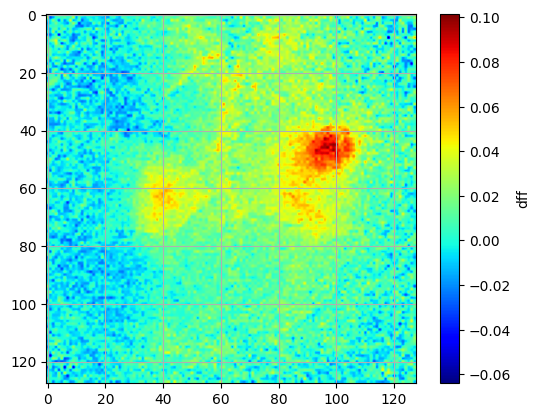

In [23]:
#plot of spatial signal without spatial smoothing
non_smoothed = plot_frame(dff_signal, frame_number, cmap = "jet", color_label = "dff")

#### 6A.2: spatial smoothing applied (gaussian, 3 pixels)

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/128 [00:00<00:47,  2.65it/s]

  2%|█▎                                                                                | 2/128 [00:00<00:39,  3.18it/s]

  2%|█▉                                                                                | 3/128 [00:00<00:38,  3.26it/s]

  3%|██▌                                                                               | 4/128 [00:01<00:39,  3.16it/s]

  4%|███▏                                                                              | 5/128 [00:01<00:38,  3.20it/s]

  5%|███▊                                                                              | 6/128 [00:01<00:37,  3.30it/s]

  5%|████▍                                                                             | 7/128 [00:02<00:38,  3.12it/s]

  6%|█████▏                                                                            | 8/128 [00:02<00:39,  3.07it/s]

  7%|█████▊                                                                            | 9/128 [00:02<00:37,  3.15it/s]

  8%|██████▎                                                                          | 10/128 [00:03<00:36,  3.21it/s]

  9%|██████▉                                                                          | 11/128 [00:03<00:35,  3.27it/s]

  9%|███████▌                                                                         | 12/128 [00:03<00:34,  3.41it/s]

 10%|████████▏                                                                        | 13/128 [00:04<00:33,  3.40it/s]

 11%|████████▊                                                                        | 14/128 [00:04<00:32,  3.52it/s]

 12%|█████████▍                                                                       | 15/128 [00:04<00:31,  3.61it/s]

 12%|██████████▏                                                                      | 16/128 [00:04<00:31,  3.51it/s]

 13%|██████████▊                                                                      | 17/128 [00:05<00:31,  3.52it/s]

 14%|███████████▍                                                                     | 18/128 [00:05<00:30,  3.58it/s]

 15%|████████████                                                                     | 19/128 [00:05<00:30,  3.56it/s]

 16%|████████████▋                                                                    | 20/128 [00:05<00:31,  3.43it/s]

 16%|█████████████▎                                                                   | 21/128 [00:06<00:31,  3.42it/s]

 17%|█████████████▉                                                                   | 22/128 [00:06<00:29,  3.53it/s]

 18%|██████████████▌                                                                  | 23/128 [00:06<00:31,  3.36it/s]

 19%|███████████████▏                                                                 | 24/128 [00:07<00:31,  3.25it/s]

 20%|███████████████▊                                                                 | 25/128 [00:07<00:31,  3.23it/s]

 20%|████████████████▍                                                                | 26/128 [00:07<00:31,  3.24it/s]

 21%|█████████████████                                                                | 27/128 [00:08<00:30,  3.31it/s]

 22%|█████████████████▋                                                               | 28/128 [00:08<00:29,  3.37it/s]

 23%|██████████████████▎                                                              | 29/128 [00:08<00:29,  3.40it/s]

 23%|██████████████████▉                                                              | 30/128 [00:08<00:29,  3.34it/s]

 24%|███████████████████▌                                                             | 31/128 [00:09<00:28,  3.45it/s]

 25%|████████████████████▎                                                            | 32/128 [00:09<00:29,  3.28it/s]

 26%|████████████████████▉                                                            | 33/128 [00:09<00:28,  3.28it/s]

 27%|█████████████████████▌                                                           | 34/128 [00:10<00:28,  3.34it/s]

 27%|██████████████████████▏                                                          | 35/128 [00:10<00:28,  3.30it/s]

 28%|██████████████████████▊                                                          | 36/128 [00:10<00:29,  3.16it/s]

 29%|███████████████████████▍                                                         | 37/128 [00:11<00:29,  3.11it/s]

 30%|████████████████████████                                                         | 38/128 [00:11<00:30,  2.94it/s]

 30%|████████████████████████▋                                                        | 39/128 [00:11<00:30,  2.96it/s]

 31%|█████████████████████████▎                                                       | 40/128 [00:12<00:30,  2.88it/s]

 32%|█████████████████████████▉                                                       | 41/128 [00:12<00:29,  2.93it/s]

 33%|██████████████████████████▌                                                      | 42/128 [00:12<00:30,  2.81it/s]

 34%|███████████████████████████▏                                                     | 43/128 [00:13<00:30,  2.76it/s]

 34%|███████████████████████████▊                                                     | 44/128 [00:13<00:30,  2.78it/s]

 35%|████████████████████████████▍                                                    | 45/128 [00:14<00:29,  2.85it/s]

 36%|█████████████████████████████                                                    | 46/128 [00:14<00:29,  2.77it/s]

 37%|█████████████████████████████▋                                                   | 47/128 [00:14<00:29,  2.73it/s]

 38%|██████████████████████████████▍                                                  | 48/128 [00:15<00:28,  2.78it/s]

 38%|███████████████████████████████                                                  | 49/128 [00:15<00:29,  2.69it/s]

 39%|███████████████████████████████▋                                                 | 50/128 [00:15<00:28,  2.76it/s]

 40%|████████████████████████████████▎                                                | 51/128 [00:16<00:27,  2.79it/s]

 41%|████████████████████████████████▉                                                | 52/128 [00:16<00:26,  2.87it/s]

 41%|█████████████████████████████████▌                                               | 53/128 [00:16<00:26,  2.82it/s]

 42%|██████████████████████████████████▏                                              | 54/128 [00:17<00:25,  2.92it/s]

 43%|██████████████████████████████████▊                                              | 55/128 [00:17<00:24,  3.02it/s]

 44%|███████████████████████████████████▍                                             | 56/128 [00:17<00:24,  2.92it/s]

 45%|████████████████████████████████████                                             | 57/128 [00:18<00:24,  2.90it/s]

 45%|████████████████████████████████████▋                                            | 58/128 [00:18<00:23,  2.98it/s]

 46%|█████████████████████████████████████▎                                           | 59/128 [00:18<00:22,  3.10it/s]

 47%|█████████████████████████████████████▉                                           | 60/128 [00:19<00:22,  3.07it/s]

 48%|██████████████████████████████████████▌                                          | 61/128 [00:19<00:21,  3.08it/s]

 48%|███████████████████████████████████████▏                                         | 62/128 [00:19<00:20,  3.21it/s]

 49%|███████████████████████████████████████▊                                         | 63/128 [00:20<00:19,  3.25it/s]

 50%|████████████████████████████████████████▌                                        | 64/128 [00:20<00:20,  3.15it/s]

 51%|█████████████████████████████████████████▏                                       | 65/128 [00:20<00:19,  3.20it/s]

 52%|█████████████████████████████████████████▊                                       | 66/128 [00:21<00:19,  3.20it/s]

 52%|██████████████████████████████████████████▍                                      | 67/128 [00:21<00:19,  3.17it/s]

 53%|███████████████████████████████████████████                                      | 68/128 [00:21<00:18,  3.27it/s]

 54%|███████████████████████████████████████████▋                                     | 69/128 [00:21<00:17,  3.31it/s]

 55%|████████████████████████████████████████████▎                                    | 70/128 [00:22<00:17,  3.33it/s]

 55%|████████████████████████████████████████████▉                                    | 71/128 [00:22<00:17,  3.24it/s]

 56%|█████████████████████████████████████████████▌                                   | 72/128 [00:22<00:17,  3.11it/s]

 57%|██████████████████████████████████████████████▏                                  | 73/128 [00:23<00:17,  3.21it/s]

 58%|██████████████████████████████████████████████▊                                  | 74/128 [00:23<00:16,  3.35it/s]

 59%|███████████████████████████████████████████████▍                                 | 75/128 [00:23<00:15,  3.52it/s]

 59%|████████████████████████████████████████████████                                 | 76/128 [00:24<00:15,  3.31it/s]

 60%|████████████████████████████████████████████████▋                                | 77/128 [00:24<00:15,  3.30it/s]

 61%|█████████████████████████████████████████████████▎                               | 78/128 [00:24<00:14,  3.41it/s]

 62%|█████████████████████████████████████████████████▉                               | 79/128 [00:24<00:13,  3.50it/s]

 62%|██████████████████████████████████████████████████▋                              | 80/128 [00:25<00:14,  3.31it/s]

 63%|███████████████████████████████████████████████████▎                             | 81/128 [00:25<00:13,  3.47it/s]

 64%|███████████████████████████████████████████████████▉                             | 82/128 [00:25<00:13,  3.37it/s]

 65%|████████████████████████████████████████████████████▌                            | 83/128 [00:26<00:12,  3.49it/s]

 66%|█████████████████████████████████████████████████████▏                           | 84/128 [00:26<00:12,  3.43it/s]

 66%|█████████████████████████████████████████████████████▊                           | 85/128 [00:26<00:13,  3.23it/s]

 67%|██████████████████████████████████████████████████████▍                          | 86/128 [00:27<00:12,  3.24it/s]

 68%|███████████████████████████████████████████████████████                          | 87/128 [00:27<00:12,  3.27it/s]

 69%|███████████████████████████████████████████████████████▋                         | 88/128 [00:27<00:12,  3.18it/s]

 70%|████████████████████████████████████████████████████████▎                        | 89/128 [00:28<00:12,  3.21it/s]

 70%|████████████████████████████████████████████████████████▉                        | 90/128 [00:28<00:11,  3.26it/s]

 71%|█████████████████████████████████████████████████████████▌                       | 91/128 [00:28<00:11,  3.28it/s]

 72%|██████████████████████████████████████████████████████████▏                      | 92/128 [00:28<00:10,  3.40it/s]

 73%|██████████████████████████████████████████████████████████▊                      | 93/128 [00:29<00:09,  3.52it/s]

 73%|███████████████████████████████████████████████████████████▍                     | 94/128 [00:29<00:09,  3.46it/s]

 74%|████████████████████████████████████████████████████████████                     | 95/128 [00:29<00:09,  3.36it/s]

 75%|████████████████████████████████████████████████████████████▊                    | 96/128 [00:30<00:09,  3.27it/s]

 76%|█████████████████████████████████████████████████████████████▍                   | 97/128 [00:30<00:09,  3.31it/s]

 77%|██████████████████████████████████████████████████████████████                   | 98/128 [00:30<00:08,  3.42it/s]

 77%|██████████████████████████████████████████████████████████████▋                  | 99/128 [00:30<00:08,  3.34it/s]

 78%|██████████████████████████████████████████████████████████████▌                 | 100/128 [00:31<00:08,  3.37it/s]

 79%|███████████████████████████████████████████████████████████████▏                | 101/128 [00:31<00:08,  3.37it/s]

 80%|███████████████████████████████████████████████████████████████▊                | 102/128 [00:31<00:08,  3.18it/s]

 80%|████████████████████████████████████████████████████████████████▍               | 103/128 [00:32<00:07,  3.24it/s]

 81%|█████████████████████████████████████████████████████████████████               | 104/128 [00:32<00:07,  3.16it/s]

 82%|█████████████████████████████████████████████████████████████████▋              | 105/128 [00:32<00:07,  3.18it/s]

 83%|██████████████████████████████████████████████████████████████████▎             | 106/128 [00:33<00:06,  3.17it/s]

 84%|██████████████████████████████████████████████████████████████████▉             | 107/128 [00:33<00:06,  3.15it/s]

 84%|███████████████████████████████████████████████████████████████████▌            | 108/128 [00:33<00:06,  3.20it/s]

 85%|████████████████████████████████████████████████████████████████████▏           | 109/128 [00:34<00:05,  3.20it/s]

 86%|████████████████████████████████████████████████████████████████████▊           | 110/128 [00:34<00:05,  3.11it/s]

 87%|█████████████████████████████████████████████████████████████████████▍          | 111/128 [00:34<00:05,  3.08it/s]

 88%|██████████████████████████████████████████████████████████████████████          | 112/128 [00:35<00:05,  2.95it/s]

 88%|██████████████████████████████████████████████████████████████████████▋         | 113/128 [00:35<00:04,  3.07it/s]

 89%|███████████████████████████████████████████████████████████████████████▎        | 114/128 [00:35<00:04,  3.13it/s]

 90%|███████████████████████████████████████████████████████████████████████▉        | 115/128 [00:36<00:04,  3.16it/s]

 91%|████████████████████████████████████████████████████████████████████████▌       | 116/128 [00:36<00:03,  3.09it/s]

 91%|█████████████████████████████████████████████████████████████████████████▏      | 117/128 [00:36<00:03,  3.17it/s]

 92%|█████████████████████████████████████████████████████████████████████████▊      | 118/128 [00:37<00:03,  3.07it/s]

 93%|██████████████████████████████████████████████████████████████████████████▍     | 119/128 [00:37<00:02,  3.19it/s]

 94%|███████████████████████████████████████████████████████████████████████████     | 120/128 [00:37<00:02,  3.17it/s]

 95%|███████████████████████████████████████████████████████████████████████████▋    | 121/128 [00:37<00:02,  3.21it/s]

 95%|████████████████████████████████████████████████████████████████████████████▎   | 122/128 [00:38<00:01,  3.23it/s]

 96%|████████████████████████████████████████████████████████████████████████████▉   | 123/128 [00:38<00:01,  3.19it/s]

 97%|█████████████████████████████████████████████████████████████████████████████▌  | 124/128 [00:38<00:01,  3.20it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 125/128 [00:39<00:00,  3.29it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▊ | 126/128 [00:39<00:00,  3.42it/s]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 127/128 [00:39<00:00,  3.50it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:40<00:00,  3.28it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:40<00:00,  3.20it/s]

frame number 200 plotted


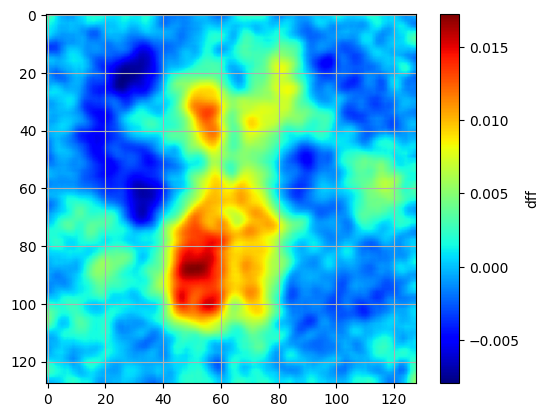

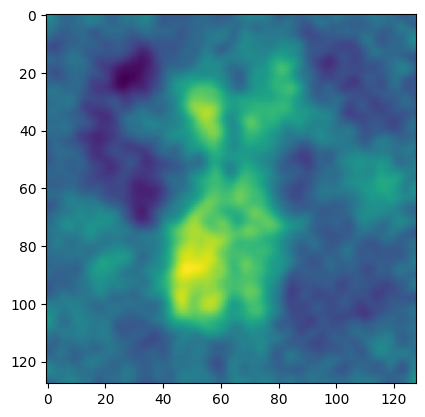

In [24]:
#plot of spatial resolution including spatial smoothing
smoothed_signal = smoothing(dff_signal)
plot_frame(smoothed_signal, 200, cmap = "jet", color_label = "dff")
plt.imshow(smoothed_signal[201])

### 6B: Temporal filtering

dff plot with chebyshev type 1 temporal filtering (high and low bandpass filter)

In [25]:
interactive_plot(smoothed_signal.mean(axis=(1,2)), title_label = "temporally smoothed signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 7: ROI plotting

### 7A: ROI full frame

plotting single flash full frame mean

In [26]:
full_roi_single, full_single_segments = avg_trials(single_indices, smoothed_signal, double=False, segment_size=200, minus=20)

In [27]:
interactive_plot(full_roi_single.mean(axis=(1,2)), title_label = "full frame single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash full frame mean

In [28]:
full_roi_double, full_double_segments = avg_trials(double_indices, smoothed_signal, double=True, segment_size=200, minus=20)

In [29]:
interactive_plot(full_roi_double.mean(axis=(1,2)), title_label = "full frame double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting NOGO full frame mean

Need to import the text file to know the location of the nogo trials

In [30]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

successfully loaded txt file


In [31]:
nogo_trials = extract_nogo(txt_file)

# nogo trials: 28


plotting nogo trials

In [32]:
full_roi_nogo, full_nogo_segments = avg_trials(nogo_trials, smoothed_signal, double=False, segment_size=200, minus=20)

In [33]:
interactive_plot(full_roi_nogo.mean(axis=(1,2)), title_label = "full frame NOGO average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

### 7B: V1 ROI

within all of v1 area at the back of the cortex the peak value at 5 frames is taken as the central point and a 15x15 grid is placed around the peak value

plotting single flash just v1 10x10 mean

In [34]:
v1_area_single = extract_v1(full_roi_single, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [35]:
interactive_plot(v1_area_single.mean(axis=(1,2)), title_label = "v1 single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash just v1 10x10 mean

In [36]:
v1_area_double = extract_v1(full_roi_double, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [37]:
interactive_plot(v1_area_double.mean(axis=(1,2)), title_label = "v1 double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 8: Line up to txt file and success vs fail rate

#### Step 8A: load in txt file from Pi_data folder

In [38]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

#extract single, double or nogo columns from the txt file
single_txt, double_txt, nogo_txt = extract_success(txt_file)

successfully loaded txt file


#### Step 8B: take the dff signal and sort them into arrays based on success or fail

In [39]:
single_success, single_fail = sort_success(single_txt, full_single_segments)

success = 22
fail = 19
total trials = 41


In [40]:
double_success, double_fail = sort_success(double_txt, full_double_segments)

success = 21
fail = 10
total trials = 31


In [41]:
nogo_success, nogo_fail = sort_success(nogo_txt, full_nogo_segments)

success = 17
fail = 11
total trials = 28


## Step 9: Save the 3D array as a TIFF stack

In [42]:
save_tiff(smoothed_signal, tiff_path_full) # full frame whole session tiff stack
save_tiff(full_roi_single, tiff_path_single) #SINGLE flash averaged response over all trials tiff stack file name to save
save_tiff(full_roi_double, tiff_path_double) #DOUBLE flash averaged response over all trials tiff stack file name to save

  0%|                                                                                        | 0/34165 [00:00<?, ?it/s]

  8%|██████                                                                    | 2800/34165 [00:00<00:01, 27894.08it/s]

 16%|████████████                                                              | 5590/34165 [00:00<00:01, 27419.86it/s]

 24%|██████████████████                                                        | 8333/34165 [00:00<00:00, 26862.82it/s]

 32%|███████████████████████▌                                                 | 11021/34165 [00:00<00:00, 26666.40it/s]

 40%|█████████████████████████████▏                                           | 13689/34165 [00:00<00:00, 26393.65it/s]

 48%|██████████████████████████████████▉                                      | 16329/34165 [00:00<00:00, 26223.63it/s]

 55%|████████████████████████████████████████▍                                | 18952/34165 [00:00<00:00, 25978.01it/s]

 63%|██████████████████████████████████████████████                           | 21550/34165 [00:00<00:00, 23821.67it/s]

 70%|███████████████████████████████████████████████████▏                     | 23970/34165 [00:00<00:00, 23864.46it/s]

 77%|████████████████████████████████████████████████████████▎                | 26378/34165 [00:01<00:00, 22732.30it/s]

 85%|█████████████████████████████████████████████████████████████▉           | 28967/34165 [00:01<00:00, 23565.51it/s]

 92%|███████████████████████████████████████████████████████████████████▎     | 31474/34165 [00:01<00:00, 23932.54it/s]

 99%|████████████████████████████████████████████████████████████████████████▍| 33884/34165 [00:01<00:00, 23639.58it/s]

100%|█████████████████████████████████████████████████████████████████████████| 34165/34165 [00:01<00:00, 24603.68it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 25008.52it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 25010.01it/s]

Combined TIFF stack saved successfully.


### Step 9B: Pickle for uploading into other scripts

In [43]:
# Now you can use these file paths in your code
with open(pickle_single_v1, 'wb') as f:
    pickle.dump(v1_area_single, f)

with open(pickle_double_v1, 'wb') as f:
    pickle.dump(v1_area_double, f)

with open(pickle_single_success_ff, 'wb') as f:
    pickle.dump(single_success, f)

with open(pickle_single_fail_ff, 'wb') as f:
    pickle.dump(single_fail, f)

with open(pickle_double_success_ff, 'wb') as f:
    pickle.dump(double_success, f)

with open(pickle_double_fail_ff, 'wb') as f:
    pickle.dump(double_fail, f)

with open(pickle_nogo_success_ff, 'wb') as f:
    pickle.dump(nogo_success, f)

with open(pickle_nogo_fail_ff, 'wb') as f:
    pickle.dump(nogo_fail, f)

# Mask and animate figures

#### currently not using these, good for visualization and flair

In [44]:
#masking = load_masks(dff_signal)
#mask, mask_outline = masking[0], masking[1]

#masked_smoothed_signal = smoothed_signal*mask
#masked_full_roi_single = full_roi_single*mask
#masked_full_roi_double = full_roi_double*mask

In [45]:
#file_path_ = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts.tiff"
#save_tiff(masked_smoothed_signal, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_single.tiff"
#save_tiff(masked_full_roi_single, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_double.tiff"
#save_tiff(masked_full_roi_double, file_path)

#print(f"TIFF stack saved at: {file_path}")